## 0.1 📚 Importing Libraries and Loading Data 🧑‍💻

In [1]:
!pip install ultralytics

In [2]:
# ──────────────────────────────
# 🧱 Standard Library Imports
# ──────────────────────────────
import argparse
import gc
import json
import os
import random
import time
import warnings
from datetime import datetime
from pathlib import Path

# ──────────────────────────────
# 📦 Third-Party Library Imports
# ──────────────────────────────

# Core ML & DL Libraries
import numpy as np
import pandas as pd
import tensorflow as tf
import torch
import torch.nn as nn
from torch.optim import Adam
from torch.utils.data import DataLoader, Dataset

# Vision & CV
import cv2
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from PIL import Image, ImageDraw
import torchvision
from torchvision import transforms
from torchvision.models.detection import (
    fasterrcnn_resnet50_fpn,
    retinanet_resnet50_fpn,
    FasterRCNN,
    RetinaNet,
    RetinaNet_ResNet50_FPN_Weights,
)

# Transformers (Hugging Face)
from transformers import (
    BlipForConditionalGeneration,
    BlipProcessor,
    GPT2LMHeadModel,
    GPT2Tokenizer,
    ViTFeatureExtractor,
    ViTModel,
)

# Visualization & Plotting
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots

# Progress & Pretty Output
from rich.console import Console
from rich.panel import Panel
from rich.progress import BarColumn, Progress, SpinnerColumn, TextColumn
from rich.table import Table
from rich.box import SIMPLE
from termcolor import colored
from prettytable import PrettyTable
from tqdm import tqdm
import colorama
from colorama import Fore, Style
import emoji

# Object Detection Utilities
from pycocotools.coco import COCO
from ultralytics import YOLO
import torch
from torch.cuda.amp import autocast, GradScaler
from rich.progress import Progress, BarColumn, TextColumn, TimeRemainingColumn
from datetime import datetime
import os
import shutil


# ──────────────────────────────
# 📌 Global Settings
# ──────────────────────────────

# Use dark theme for all plotly visuals
px.defaults.template = "plotly_dark"

# Suppress specific transformer-related warnings
warnings.filterwarnings("ignore", message="Some weights of ViTModel were not initialized")

# Initialize console for rich outputs
console = Console()
colorama.init(autoreset=True)


In [3]:
def print_colored(text, color, bold=False, center=False, width=60):
    """Print colored text in the terminal with optional bold and centering."""
    colors = {
        "red": "\033[91m", "green": "\033[92m", "yellow": "\033[93m",
        "blue": "\033[94m", "cyan": "\033[96m", "magenta": "\033[95m",
        "reset": "\033[0m", "bold": "\033[1m"
    }
    colored_text = f"{colors[color]}{text}{colors['reset']}"
    if bold:
        colored_text = f"{colors['bold']}{colored_text}{colors['reset']}"
    if center:
        colored_text = colored_text.center(width)
    print(colored_text)

In [4]:
def simulate_loading(task="Processing"):
    """Simulate a smooth loading effect."""
    for dot in ["⏳", "⌛", "⏳"]:
        print_colored(f"    {dot} {task}...",'green')
        time.sleep(0.5)
    print("    ✅ Done!            ")

## **0.2 Setup the device**

In [5]:
def setup_device():
    try:
        device = "cuda" if tf.config.list_physical_devices('GPU') else "cpu"
        print_colored(f"⚙️ Running on: {device}",'green',True,)
        return device
    except Exception as e:
        print(f"❌ Error setting up device: {e}")


In [6]:
device = setup_device()

⚙️ Running on: cuda


# ==========================
# **📂 1. Preparing and Visualizing Our Dataset**
# ==========================

## **1.1  📂 Define dataset path**

In [7]:
dataset_root_dir = Path("/kaggle/input/2017-2017")

# Directories for images and annotations
images_dir = dataset_root_dir / "train2017" / "train2017"
test_images_dir = dataset_root_dir / "test2017" / "test2017"
val_images_dir = dataset_root_dir / "val2017" / "val2017"
unlabeled_images_dir = dataset_root_dir / "unlabeled2017" / "unlabeled2017"

annotations_dir = dataset_root_dir / "annotations_trainval2017" / "annotations"
CAPTIONS_TRAIN = annotations_dir / "captions_train2017.json"

# Directories for annotations (train, val)
train_ann_path = annotations_dir / "instances_train2017.json"
val_ann_path = annotations_dir / "instances_val2017.json"

In [8]:
# Create a dictionary of annotation paths
ANNOTATION_PATHS = {
    "captions_train": os.path.join(annotations_dir, "captions_train2017.json"),
    "captions_val": os.path.join(annotations_dir, "captions_val2017.json"),
    "instances_train": os.path.join(annotations_dir, "instances_train2017.json"),
    "instances_val": os.path.join(annotations_dir, "instances_val2017.json"),
    "person_keypoints_train": os.path.join(annotations_dir, "person_keypoints_train2017.json"),
    "person_keypoints_val": os.path.join(annotations_dir, "person_keypoints_val2017.json"),
    "image_info_test_dev": os.path.join(dataset_root_dir, "image_info_test2017/annotations/image_info_test-dev2017.json"),
    "image_info_test": os.path.join(dataset_root_dir, "image_info_test2017/annotations/image_info_test2017.json"),
    "image_info_unlabeled": os.path.join(dataset_root_dir, "image_info_unlabeled2017/annotations/image_info_unlabeled2017.json"),
}

In [9]:
IMAGE_FOLDERS = {
    "train": "/kaggle/input/2017-2017/train2017/train2017/",
    "val": "/kaggle/input/2017-2017/val2017/val2017/",
    "test": "/kaggle/input/2017-2017/test2017/test2017/",
    "unlabeled": "/kaggle/input/2017-2017/unlabeled2017/unlabeled2017/"
}

In [10]:
console.print(f"[bold green]Dataset Root Directory:[/bold green] {dataset_root_dir}")
console.print(f"[bold green]Train Images Directory:[/bold green] {images_dir}")
console.print(f"[bold green]Test Images Directory:[/bold green] {test_images_dir}")
console.print(f"[bold green]Validation Images Directory:[/bold green] {val_images_dir}")
console.print(f"[bold green]Unlabeled Images Directory:[/bold green] {unlabeled_images_dir}")
console.print(f"[bold green]Train Annotations Path:[/bold green] {train_ann_path}")
console.print(f"[bold green]Validation Annotations Path:[/bold green] {val_ann_path}")
console.print(f"[bold green]Captions Train File Path:[/bold green] {CAPTIONS_TRAIN}")

Dataset Root Directory: /kaggle/input/2017-2017

Train Images Directory: /kaggle/input/2017-2017/train2017/train2017

Test Images Directory: /kaggle/input/2017-2017/test2017/test2017

Validation Images Directory: /kaggle/input/2017-2017/val2017/val2017

Unlabeled Images Directory: /kaggle/input/2017-2017/unlabeled2017/unlabeled2017

Train Annotations Path: /kaggle/input/2017-2017/annotations_trainval2017/annotations/instances_train2017.json

Validation Annotations Path: /kaggle/input/2017-2017/annotations_trainval2017/annotations/instances_val2017.json

Captions Train File Path: /kaggle/input/2017-2017/annotations_trainval2017/annotations/captions_train2017.json

In [11]:
def get_image_dir_data(image_type="train"):
    """
    Dynamically retrieves the directory path based on the image type (train, test, val, or unlabeled).
    
    Parameters:
        image_type (str): The type of images to retrieve, default is 'train'.
        
    Returns:
        Path: The directory path for the specified image type.
    """
    image_type_dirs = {
        "train": images_dir,
        "test": test_images_dir,
        "val": val_images_dir,
        "unlabeled": unlabeled_images_dir
    }
    
    return image_type_dirs.get(image_type, None)

In [12]:
train_image_dir = get_image_dir_data("train")
console.print(f"[bold cyan]Train Image Directory Retrieved Dynamically:[/bold cyan] {train_image_dir}")

Train Image Directory Retrieved Dynamically: /kaggle/input/2017-2017/train2017/train2017

In [13]:
train_image_dir = get_image_dir_data("val")
console.print(f"[bold cyan]Train Image Directory Retrieved Dynamically:[/bold cyan] {train_image_dir}")

Train Image Directory Retrieved Dynamically: /kaggle/input/2017-2017/val2017/val2017

In [14]:
train_image_dir = get_image_dir_data("test")
console.print(f"[bold cyan]Train Image Directory Retrieved Dynamically:[/bold cyan] {train_image_dir}")

Train Image Directory Retrieved Dynamically: /kaggle/input/2017-2017/test2017/test2017

In [15]:
# Caption Annotations (Image Captioning Tasks)
CAPTIONS_TRAIN = annotations_dir / "captions_train2017.json"
CAPTIONS_VAL = annotations_dir / "captions_val2017.json"

# Object Detection Annotations (Bounding Boxes)
INSTANCES_TRAIN = annotations_dir / "instances_train2017.json"
INSTANCES_VAL = annotations_dir / "instances_val2017.json"

# Human Keypoints Annotations (Pose Estimation)
KEYPOINTS_TRAIN = annotations_dir / "person_keypoints_train2017.json"
KEYPOINTS_VAL = annotations_dir / "person_keypoints_val2017.json"

# ==========================
# 🏷️ Test & Unlabeled Image Info
# ==========================
image_info_dir = dataset_root_dir / "image_info_test2017/annotations"
IMAGE_INFO_TEST_DEV = image_info_dir / "image_info_test-dev2017.json"
IMAGE_INFO_TEST = image_info_dir / "image_info_test2017.json"
IMAGE_INFO_UNLABELED = image_info_dir / "image_info_unlabeled2017.json"

# ==========================
# 🖼️ Image Directories
# ==========================
images_dir = dataset_root_dir / "train2017/train2017"
IMAGES_TRAIN = images_dir
IMAGES_VAL = dataset_root_dir / "val2017/val2017"
IMAGES_TEST = dataset_root_dir / "test2017/test2017"
IMAGES_UNLABELED = dataset_root_dir / "unlabeled2017/unlabeled2017"

# ==========================
# ✅ PRINTING ALL PATHS in Table Format
# ==========================
console.print("=" * 100)
console.print("[bold green]📂 COCO 2017 DATASET: PATH DEFINITIONS[/bold green]".center(100, " "))
console.print("=" * 100 + "\n")

# Create a table for the paths
table = Table(show_header=True, header_style="bold magenta", box=SIMPLE)
table.add_column("Category", style="dim", width=30)
table.add_column("Path", style="cyan")

# Add rows for each annotation and image path
table.add_row("📝 Training Captions", str(CAPTIONS_TRAIN))
table.add_row("📝 Validation Captions", str(CAPTIONS_VAL))

table.add_row("📦 Training Object Instances", str(INSTANCES_TRAIN))
table.add_row("📦 Validation Object Instances", str(INSTANCES_VAL))

table.add_row("🏃‍♂️ Training Keypoints", str(KEYPOINTS_TRAIN))
table.add_row("🏃‍♂️ Validation Keypoints", str(KEYPOINTS_VAL))

table.add_row("🏷️ Test-Dev Info", str(IMAGE_INFO_TEST_DEV))
table.add_row("🏷️ Test Set Info", str(IMAGE_INFO_TEST))
table.add_row("🏷️ Unlabeled Image Info", str(IMAGE_INFO_UNLABELED))

table.add_row("🖼️ Training Images", str(IMAGES_TRAIN))
table.add_row("🖼️ Validation Images", str(IMAGES_VAL))
table.add_row("🖼️ Test Images", str(IMAGES_TEST))
table.add_row("🖼️ Unlabeled Images", str(IMAGES_UNLABELED))

# Print the table
console.print(table)

console.print("=" * 100)
console.print("[bold yellow]🎯 All dataset paths are successfully defined and ready for use! 🚀[/bold yellow]")
console.print("=" * 100 + "\n")

====================================================================================================

📂 COCO 2017 DATASET: PATH DEFINITIONS

====================================================================================================

 Category                         Path                                                                            
 ───────────────────────────────────────────────────────────────────────────────────────────────────────────────── 
  📝 Training Captions             /kaggle/input/2017-2017/annotations_trainval2017/annotations/captions_train20…  
  📝 Validation Captions           /kaggle/input/2017-2017/annotations_trainval2017/annotations/captions_val2017…  
  📦 Training Object Instances     /kaggle/input/2017-2017/annotations_trainval2017/annotations/instances_train2…  
  📦 Validation Object Instances   /kaggle/input/2017-2017/annotations_trainval2017/annotations/instances_val201…  
  🏃‍♂️ Training Keypoints           /kaggle/input/2017-2017/annotations_trainval2017/annotations/person_keypoints…  
  🏃‍♂️ Validation Keypoints         /kaggle/input/2017-2017/annotations_trainval2017/annotations/person_keypoints…  
  🏷️ Test-Dev Info                  /kaggle/input/2017-2017/image_info_test2017/annotations/image_info_test-dev20…  
  🏷️ Test Set Info                  /kaggle/input/2017-2017/image_info_test2017/annotations/image_info_test2017.j…  
  🏷️ Unlabeled Image Info           /kaggle/input/2017-2017/image_info_test2017/annotations/image_info_unlabeled2…  
  🖼️ Training Images                /kaggle/input/2017-2017/train2017/train2017                                     
  🖼️ Validation Images              /kaggle/input/2017-2017/val2017/val2017                                         
  🖼️ Test Images                    /kaggle/input/2017-2017/test2017/test2017                                       
  🖼️ Unlabeled Images               /kaggle/input/2017-2017/unlabeled2017/unlabeled2017                            

====================================================================================================

🎯 All dataset paths are successfully defined and ready for use! 🚀

====================================================================================================

## **1.2 📌 Get dataset statistics**

In [16]:
def coco_dataset_summary_all():
    """
    Generate and display a detailed summary for all COCO annotation datasets with enhanced visuals.
    
    Returns:
        None
    """
    for name, path in CAPTIONS_TRAIN.items():
        print("\n" + "=" * 80)
        print_colored(f"📊 COCO DATASET SUMMARY - {name.upper()} 📊", "cyan", bold=True, center=True, width=80)
        print("=" * 80)
    
        simulate_loading(f"🔍 Loading & Analyzing {name.upper()} dataset...")
    
        # ✅ Load annotations for the current dataset
        annotations = load_coco_annotations(path)
        if annotations is None:
            print_colored(f"❌ Failed to load {name.upper()} annotations.", "red", bold=True)
            continue
    
        # ✅ Extract dataset statistics
        num_images = len(set(img["id"] for img in annotations.get("images", [])))
        num_annotations = len(annotations.get("annotations", []))
        num_categories = len(set(cat["id"] for cat in annotations.get("categories", [])))

        print_colored("\n📌 Dataset Overview:", "yellow", bold=True)
        print_colored(f"🖼️  Total Images:          {num_images:,}", "cyan", bold=True)
        print_colored(f"📝  Total Annotations:     {num_annotations:,}", "cyan", bold=True)
        print_colored(f"🏷️  Unique Categories:     {num_categories:,}", "cyan", bold=True)
    
        # ✅ Create DataFrame for visualization
        summary_df = pd.DataFrame({
            "Metric": ["Total Images", "Total Annotations", "Unique Categories"],
            "Value": [num_images, num_annotations, num_categories]
        })
    
        # ✅ Generate an interactive bar chart
        print_colored("\n📊 Generating Dataset Visualization...", "magenta", bold=True)
        simulate_loading("📈 Rendering Chart...")
    
        fig = px.bar(
            summary_df, x="Metric", y="Value", 
            title=f"<b><span style='color:#FF5733;'>📊 {name.upper()} Dataset Summary</span></b>",
            text_auto=True, color="Metric", 
            color_discrete_sequence=px.colors.sequential.Viridis
        )
    
        # ✅ Improve layout aesthetics
        fig.update_layout(
            title_x=0.5,  
            title_font=dict(size=24, family="Arial, sans-serif"),  
            font=dict(size=14, color="white"),  
            xaxis=dict(title_font=dict(size=16, family="Arial, sans-serif")),
            yaxis=dict(title_font=dict(size=16, family="Arial, sans-serif")),
            showlegend=True,
            plot_bgcolor="rgba(0,0,0,0)",  
            paper_bgcolor="rgba(0,0,0,0)"  
        )
    
        fig.show()
    
        print("\n" + "=" * 80)
        print_colored(f"✅ {name.upper()} Summary Generated Successfully! 🚀", "green", bold=True, center=True, width=80)
        print("=" * 80)


In [17]:
#coco_dataset_summary_all()

## **1.3 🖼️ Display Sample Images with Captions**

In [18]:
def show_sample_images(dataset_type, num_samples=5):
    """
    Display sample images from the COCO dataset with bounding boxes and captions.

    Parameters:
        dataset_type (str): The dataset split ('train' or 'val').
        num_samples (int): Number of images to display.

    Returns:
        None
    """
    dataset_type = dataset_type.lower()

    if dataset_type not in ["train", "val"]:
        print(f"❌ Invalid dataset type: {dataset_type}. Choose 'train' or 'val'.")
        return

    # ✅ Get annotation file paths dynamically
    captions_path = ANNOTATION_PATHS[f"captions_{dataset_type}"]
    instances_path = ANNOTATION_PATHS[f"instances_{dataset_type}"]

    # ✅ Load annotations
    with open(captions_path, "r") as f:
        captions_data = json.load(f)

    with open(instances_path, "r") as f:
        instances_data = json.load(f)

    print("\n" + "=" * 80)
    print(f"📸 DISPLAYING SAMPLE IMAGES FROM {dataset_type.upper()} SET 📸".center(80))
    print("=" * 80)

    # ✅ Select random images
    image_filenames = {img["id"]: img["file_name"] for img in instances_data["images"]}
    selected_image_ids = np.random.choice(list(image_filenames.keys()), num_samples, replace=False)

    # ✅ Set image folder based on dataset type
    image_folder = IMAGE_FOLDERS[dataset_type]

    fig, axes = plt.subplots(1, num_samples, figsize=(30, 10))

    for idx, image_id in enumerate(selected_image_ids):
        img_name = image_filenames[image_id]
        img_path = os.path.join(image_folder, img_name)
        image = Image.open(img_path)

        # ✅ Get caption (if available)
        captions = [ann["caption"] for ann in captions_data["annotations"] if ann["image_id"] == image_id]
        caption_text = captions[0] if captions else "No Caption Available"

        # ✅ Get bounding boxes
        image_annotations = [ann for ann in instances_data["annotations"] if ann["image_id"] == image_id]

        # ✅ Plot image with annotations
        axes[idx].imshow(image)
        axes[idx].set_title(f"{caption_text}", fontsize=12, color='cyan')
        axes[idx].axis("off")

        for ann in image_annotations:
            if "bbox" in ann:
                x, y, w, h = ann["bbox"]
                rect = patches.Rectangle((x, y), w, h, linewidth=2, edgecolor="red", facecolor="none")
                axes[idx].add_patch(rect)

    plt.tight_layout()
    plt.show()

    print("\n" + "=" * 80)
    print(f"✅ Image Display Completed for {dataset_type.upper()}! 🚀".center(80))
    print("=" * 80)


                  📸 DISPLAYING SAMPLE IMAGES FROM TRAIN SET 📸                   


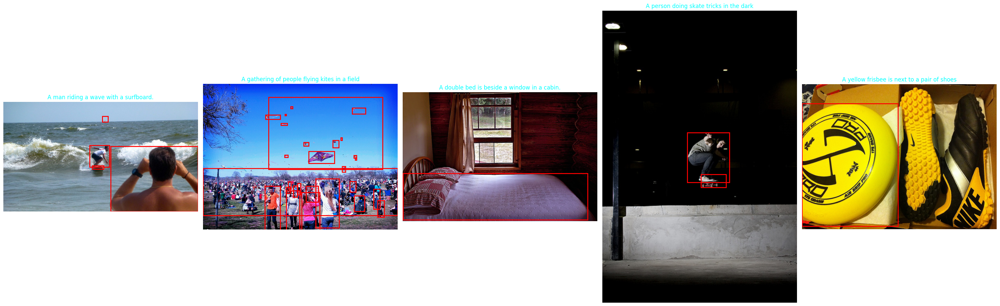


                     ✅ Image Display Completed for TRAIN! 🚀                     


In [19]:
show_sample_images("train", num_samples=5)  # Show 5 random train images


                   📸 DISPLAYING SAMPLE IMAGES FROM VAL SET 📸                    


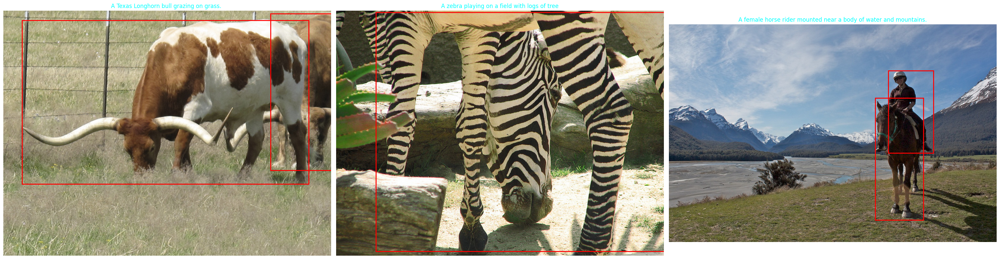


                      ✅ Image Display Completed for VAL! 🚀                      


In [20]:
show_sample_images("val", num_samples=3)    # Show 3 random validation images

# ==========================
# **🛠️ 2⃣ Preprocessing Images & Captions**
# ==========================

## **2.1 🔧 COCODataset Class Definition**

In [21]:
class COCODataset(Dataset):
    """
    A custom Dataset class for loading and processing COCO dataset annotations
    and images, including object detection bounding boxes and labels.

    Parameters:
        img_folder (str): Path to the folder containing images.
        ann_file (str): Path to the COCO annotation file (JSON).
        transforms (callable, optional): A function/transform to apply to the images.
    """
    def __init__(self, img_folder, ann_file, transforms=None):
        self.coco = COCO(ann_file)  # Load COCO annotations
        self.img_folder = img_folder
        self.ids = list(self.coco.imgs.keys())[:2500]  # Using a subset of 2500 images
        self.transforms = transforms

        # Inform about dataset loading
        console.print("[bold green]COCO Dataset Loaded Successfully![/bold green]")

    def __getitem__(self, idx):
        """
        Retrieves an image and its corresponding annotations.

        Parameters:
            idx (int): Index of the image to retrieve.

        Returns:
            tuple: (image, target) where 'image' is the processed image, 
                   and 'target' is a dictionary containing boxes and labels.
        """
        img_id = self.ids[idx]
        ann_ids = self.coco.getAnnIds(imgIds=img_id)
        anns = self.coco.loadAnns(ann_ids)
        
        boxes = []
        labels = []
        for ann in anns:
            x, y, w, h = ann['bbox']
            boxes.append([x, y, x + w, y + h])
            labels.append(ann['category_id'])

        boxes = torch.as_tensor(boxes, dtype=torch.float32)
        labels = torch.as_tensor(labels, dtype=torch.int64)

        image_info = self.coco.loadImgs(img_id)[0]
        img_path = os.path.join(self.img_folder, image_info['file_name'])
        img = Image.open(img_path).convert("RGB")

        if self.transforms:
            img = self.transforms(img)

        target = {'boxes': boxes, 'labels': labels, 'image_id': torch.tensor([img_id])}
        return img, target

    def __len__(self):
        """
        Returns the total number of images in the dataset.
        """
        return len(self.ids)

## **2.2 🖼️ Visualize Image with Bounding Boxes**

In [22]:
def show_image(img, boxes, labels):
    """
    Visualizes an image with its bounding boxes and labels.

    Parameters:
        img (Tensor): The image tensor to display.
        boxes (Tensor): Bounding boxes to display.
        labels (Tensor): Labels corresponding to the bounding boxes.

    Returns:
        PIL Image: Image with bounding boxes drawn.
    """
    img = transforms.ToPILImage()(img.cpu())
    draw = ImageDraw.Draw(img)
    for box, label in zip(boxes, labels):
        draw.rectangle(box.tolist(), outline='red', width=2)
        draw.text((box[0], box[1]), str(label.item()), fill='red')
    return img


## **2.3 🧑‍💻 Data Pipeline & Augmentation**

### **2.3.1 Create Datasets**

In [23]:
# Data transformation (e.g., to tensor) and augmentation (e.g., flip, color jitter)
transform = transforms.Compose([transforms.ToTensor()])

# Initialize dataset

# Train_dataset
train_dataset = COCODataset(
    img_folder=images_dir ,
    ann_file=train_ann_path ,
    transforms=transform
)

# Val_dataset
val_dataset = COCODataset(
    img_folder=val_images_dir  ,
    ann_file=val_ann_path ,
    transforms=transform
)

loading annotations into memory...
Done (t=15.25s)
creating index...
index created!


COCO Dataset Loaded Successfully!

loading annotations into memory...
Done (t=0.58s)
creating index...
index created!


COCO Dataset Loaded Successfully!

### **2.3.2 Show Some Samples of the images**

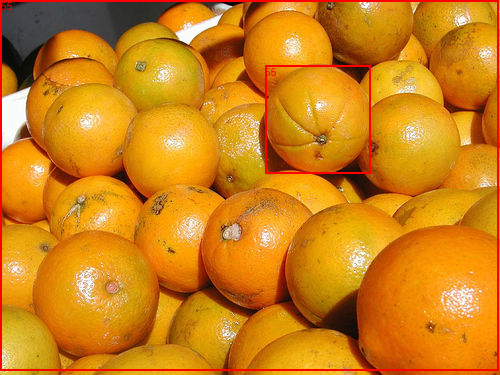

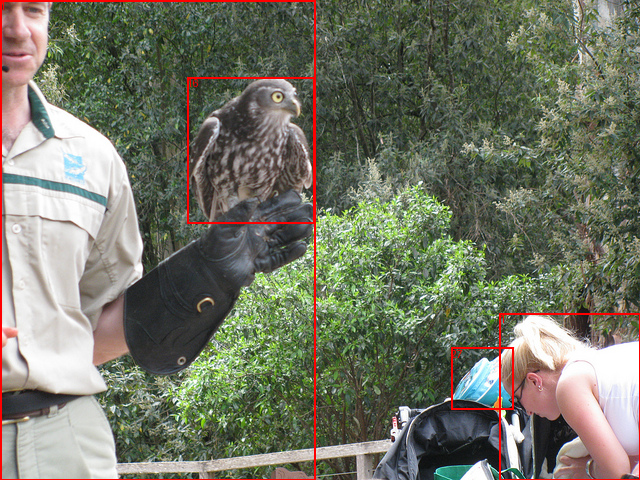

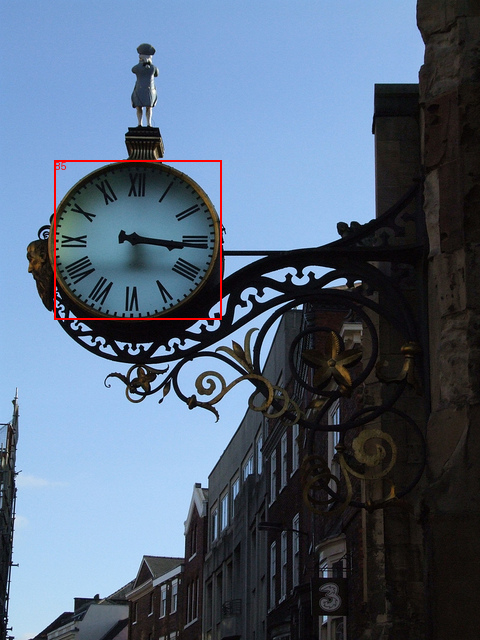

In [24]:
# Show Sample of the train_data
for i in range(3):
    img, target = train_dataset[random.randint(0, len(train_dataset) - 1)]
    display(show_image(img, target['boxes'], target['labels']))

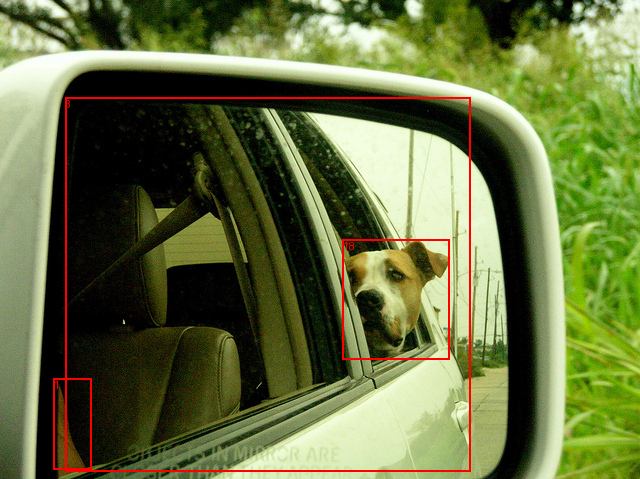

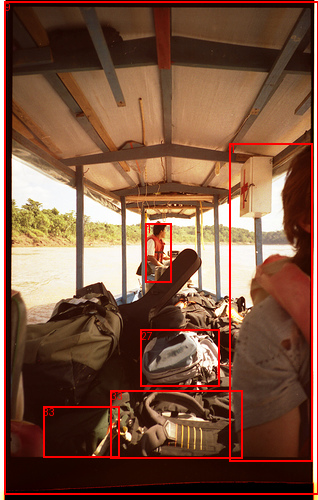

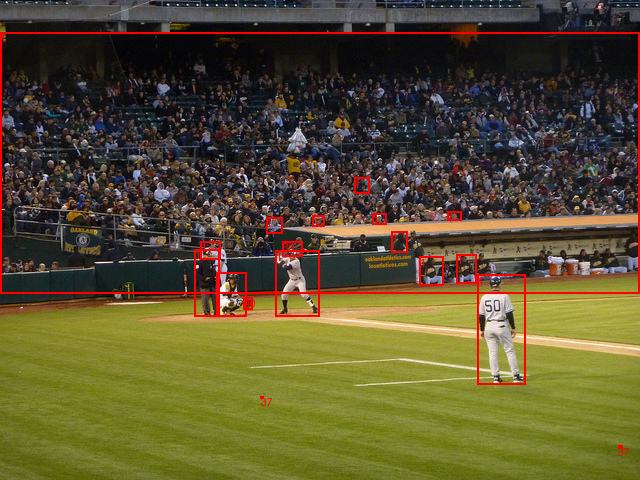

In [25]:
# Show Sample of the train_data
for i in range(3):
    img, target = val_dataset[random.randint(0, len(val_dataset) - 1)]
    display(show_image(img, target['boxes'], target['labels']))

### **2.3.3  Initializing DataLoader for training and validation datasets**

- Initializing DataLoader for Training
    - The training DataLoader loads data in batches, shuffles the dataset for each epoch to avoid overfitting, and ensures parallel data loading to optimize training time.
    
- Initializing DataLoader for Validation
    - For validation, we don't shuffle the data as we want a consistent order to evaluate the model performance.additionally, validation data is loaded with no parallelism to save resources.

- Why the Custom collate_fn?
    - The collate_fn function is customized to handle datasets with variable-length outputs. 
    - In this case, it's required to handle the variable bounding box and label sizes for each image.
    - This lambda function ensures that each batch of data is properly packed into the correct format for model training or evaluation.

In [26]:
train_loader = DataLoader(
    dataset=train_dataset,               # Using the train dataset
    batch_size=2,                        # Batches of 2 images for each iteration
    shuffle=True,                        # Shuffle the dataset for each epoch
    collate_fn=lambda x: tuple(zip(*x)), # Custom collate_fn to handle variable-length outputs like bounding boxes
    num_workers=4                        # Parallel data loading to speed up processing
)

In [27]:
val_loader = DataLoader(
    dataset=val_dataset,                 # Using the validation dataset
    batch_size=2,                        # Same batch size as for training
    shuffle=False,                       # No shuffling during validation
    collate_fn=lambda x: tuple(zip(*x)), # Custom collate_fn as above
    num_workers=2                        # Fewer workers since it's for validation, can be adjusted based on resources
)

### **2.3.4 : Simple data augmentation and display**

loading annotations into memory...
Done (t=15.90s)
creating index...
index created!


COCO Dataset Loaded Successfully!

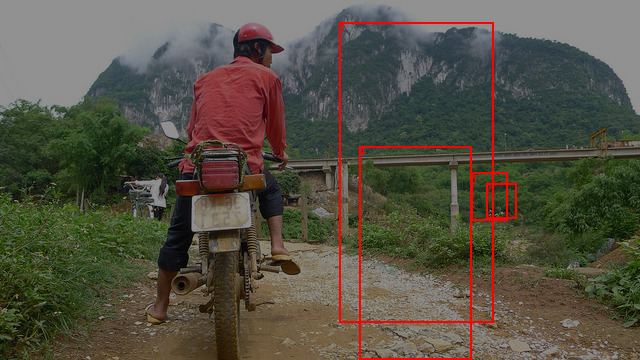

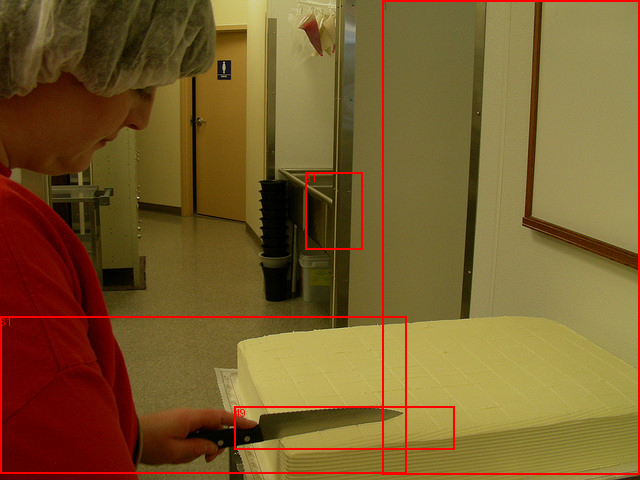

In [28]:
augment = transforms.Compose([
    transforms.RandomHorizontalFlip(p=1.0),   # Randomly flip images horizontally with 100% probability
    transforms.ColorJitter(brightness=0.5),   # Adjust brightness randomly with a factor of 0.5
    transforms.ToTensor()                     # Convert image to tensor format for PyTorch
])

augmented_dataset = COCODataset(
    img_folder=images_dir,    # Directory containing images
    ann_file=train_ann_path,  # Path to the annotations file (COCO format)
    transforms=augment        # The augmentations to apply on images
)

for i in range(2):
    # Get an augmented image and its corresponding target (bounding boxes, labels)
    img, target = augmented_dataset[i]
    
    # Display the image with bounding boxes and labels using the custom `show_image` function
    display(show_image(img, target['boxes'], target['labels']))

# **3. Model Setup**
- We begin by setting up the RetinaNet model with the ResNet50 backbone pre-trained on the COCO dataset. The model is then moved to the specified device (GPU or CPU) for training.

In [29]:
# Initialize RetinaNet model with ResNet50 backbone
weights = RetinaNet_ResNet50_FPN_Weights.COCO_V1
model = retinanet_resnet50_fpn(weights=weights)
model.to(device)

RetinaNet(
  (backbone): BackboneWithFPN(
    (body): IntermediateLayerGetter(
      (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
      (bn1): FrozenBatchNorm2d(64, eps=0.0)
      (relu): ReLU(inplace=True)
      (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
      (layer1): Sequential(
        (0): Bottleneck(
          (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn1): FrozenBatchNorm2d(64, eps=0.0)
          (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (bn2): FrozenBatchNorm2d(64, eps=0.0)
          (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn3): FrozenBatchNorm2d(256, eps=0.0)
          (relu): ReLU(inplace=True)
          (downsample): Sequential(
            (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
            (1): FrozenBatchNorm2d(256, eps=0.0)


In [30]:
params = [p for p in model.parameters() if p.requires_grad]
optimizer = torch.optim.SGD(params, lr=0.005, momentum=0.9, weight_decay=0.0005)
lr_scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=3, gamma=0.1)

## **3.1 Training Loop:**
The `train_one_epoch` function manages the training process by iterating over the training data and updating the model weights. We also include a robust check to only process images with valid bounding boxes.

In [31]:
def train_one_epoch(model, optimizer, data_loader, device):
    """
    Train the model for one epoch.

    Args:
    - model (torch.nn.Module): The model to be trained.
    - optimizer (torch.optim.Optimizer): The optimizer used for training.
    - data_loader (torch.utils.data.DataLoader): The data loader for the training data.
    - device (torch.device): The device to perform training on (CPU or GPU).

    Returns:
    - avg_loss (float): The average training loss for this epoch.
    """
    model.train()  # Set the model to training mode
    epoch_loss = 0
    total_batches = len(data_loader)

    # Initialize tqdm for training batches with colorful progress bar
    loop = tqdm(data_loader, total=total_batches, desc=emoji.emojize(":rocket: Training"), unit="batch", leave=False)
    
    for images, targets in loop:
        valid_images = []
        valid_targets = []

        # Filter valid images with bounding boxes
        for img, target in zip(images, targets):
            if target['boxes'].shape[0] > 0:  # only process images with valid boxes
                valid_images.append(img)
                valid_targets.append(target)

        if len(valid_images) == 0:
            continue

        valid_images = [img.to(device) for img in valid_images]
        valid_targets = [{k: v.to(device) for k, v in t.items()} for t in valid_targets]

        # Forward pass with both images and targets
        loss_dict = model(valid_images, valid_targets)
        losses = sum(loss for loss in loss_dict.values())

        # Backpropagation
        optimizer.zero_grad()
        losses.backward()
        optimizer.step()

        epoch_loss += losses.item()

        loop.set_postfix(loss=losses.item())  # Update tqdm progress bar with the current loss

    avg_loss = epoch_loss / len(data_loader)  # Calculate average loss for this epoch
    return avg_loss

In [32]:
def evaluate(model, data_loader, device):
    """
    Evaluate the model on the validation set and calculate the mean Average Precision (mAP).
    
    Args:
    - model (torch.nn.Module): The trained model to evaluate.
    - data_loader (torch.utils.data.DataLoader): The data loader for the validation data.
    - device (torch.device): The device to perform evaluation on (CPU or GPU).
    
    Returns:
    - avg_mAP (float): The average mean Average Precision (mAP) for this validation epoch.
    """
    model.eval()  # Set the model to evaluation mode
    mAP = 0
    num_batches = 0

    # Initialize tqdm for validation batches
    loop = tqdm(data_loader, desc="Evaluating", unit="batch", leave=False)

    with torch.no_grad():
        for images, targets in loop:
            valid_targets = []
            valid_images = []

            # Filter only images with valid bounding boxes
            for img, target in zip(images, targets):
                if target['boxes'].shape[0] > 0:  # Only process images with valid boxes
                    valid_images.append(img)
                    valid_targets.append(target)

            # Skip if no valid images are found
            if len(valid_images) == 0:
                continue

            # Move images to the correct device (GPU or CPU)
            valid_images = [img.to(device) for img in valid_images]
            targets = [{k: v.to(device) for k, v in t.items()} for t in valid_targets]

            # Forward pass (including loss calculation)
            outputs = model(valid_images)

            # Check if model returns loss during evaluation
            if isinstance(outputs, tuple) and len(outputs) == 2:
                # Assume the first element is the predicted output, and second is the loss
                outputs, loss_dict = outputs
                losses = sum(loss for loss in loss_dict.values())
            else:
                # If no loss, just set it to 0
                losses = 0

            # Update mAP (mean Average Precision) calculation
            mAP += sum([1 for out in outputs if len(out['boxes']) > 0])
            num_batches += 1

    # Calculate average mAP
    avg_mAP = mAP / num_batches

    return avg_mAP


In [33]:
def train(model, optimizer, train_loader, val_loader, device, epochs=2, lr_scheduler=None, save_path="model_checkpoint.pth"):
    """
    Train the model for multiple epochs and evaluate its performance.
    
    Args:
    - model (torch.nn.Module): The model to be trained.
    - optimizer (torch.optim.Optimizer): The optimizer used for training.
    - train_loader (torch.utils.data.DataLoader): The data loader for the training data.
    - val_loader (torch.utils.data.DataLoader): The data loader for the validation data.
    - device (torch.device): The device to perform training on (CPU or GPU).
    - epochs (int, optional): The number of epochs to train the model. Default is 2.
    - lr_scheduler (torch.optim.lr_scheduler, optional): The learning rate scheduler to adjust the learning rate. Default is None.
    - save_path (str, optional): The path to save the best model checkpoint. Default is "model_checkpoint.pth".
    
    Returns:
    - history (dict): A dictionary containing the training history (train_loss, val_mAP).
    """
    history = {"train_loss": [], "val_mAP": []}
    
    result_table = PrettyTable()
    result_table.field_names = ["Epoch", "Train Loss", "Val mAP"]
    
    # Loop over epochs
    for epoch in range(epochs):
        # Print epoch header with color
        print(f"\n{Fore.CYAN}{'='*10} Epoch {epoch+1}/{epochs} {'='*10}{Style.RESET_ALL}")

        # Training phase
        print(Fore.GREEN + "Training phase:" + Style.RESET_ALL)
        train_loss = train_one_epoch(model, optimizer, train_loader, device)

        # Validation phase
        print(Fore.YELLOW + "Validation phase:" + Style.RESET_ALL)
        val_metric = evaluate(model, val_loader, device)

        # Record the results
        history["train_loss"].append(train_loss)
        history["val_mAP"].append(val_metric)

        # Add metrics to result table
        result_table.add_row([epoch+1, round(train_loss, 4), round(val_metric, 4)])

        # Print the result table in an impressive way
        print(Fore.MAGENTA + str(result_table) + Style.RESET_ALL)

        # Save model checkpoint if validation mAP improves
        if epoch == 0 or val_metric > max(history["val_mAP"]):
            print(Fore.BLUE + f"Saving model checkpoint at epoch {epoch+1} with mAP: {val_metric}" + Style.RESET_ALL)
            torch.save(model.state_dict(), save_path)

        # Update learning rate scheduler if provided
        if lr_scheduler:
            lr_scheduler.step()

    return history

In [34]:
from torch.optim.lr_scheduler import StepLR
lr_scheduler = StepLR(optimizer, step_size=10, gamma=0.1)

In [35]:
history = train(model, optimizer, train_loader, val_loader, device, epochs=10, lr_scheduler=lr_scheduler, save_path="best_model_fast_resnet.pth")


========== Epoch 1/10 ==========
Training phase:


Validation phase:


+-------+------------+---------+
| Epoch | Train Loss | Val mAP |
+-------+------------+---------+
|   1   |   0.936    |  1.9848 |
+-------+------------+---------+
Saving model checkpoint at epoch 1 with mAP: 1.9847878302642115

========== Epoch 2/10 ==========
Training phase:


Validation phase:


+-------+------------+---------+
| Epoch | Train Loss | Val mAP |
+-------+------------+---------+
|   1   |   0.936    |  1.9848 |
|   2   |   0.7368   |  1.9848 |
+-------+------------+---------+

========== Epoch 3/10 ==========
Training phase:


Validation phase:


+-------+------------+---------+
| Epoch | Train Loss | Val mAP |
+-------+------------+---------+
|   1   |   0.936    |  1.9848 |
|   2   |   0.7368   |  1.9848 |
|   3   |   0.6313   |  1.9848 |
+-------+------------+---------+

========== Epoch 4/10 ==========
Training phase:


Validation phase:


+-------+------------+---------+
| Epoch | Train Loss | Val mAP |
+-------+------------+---------+
|   1   |   0.936    |  1.9848 |
|   2   |   0.7368   |  1.9848 |
|   3   |   0.6313   |  1.9848 |
|   4   |   0.6072   |  1.9848 |
+-------+------------+---------+

========== Epoch 5/10 ==========
Training phase:


Validation phase:


+-------+------------+---------+
| Epoch | Train Loss | Val mAP |
+-------+------------+---------+
|   1   |   0.936    |  1.9848 |
|   2   |   0.7368   |  1.9848 |
|   3   |   0.6313   |  1.9848 |
|   4   |   0.6072   |  1.9848 |
|   5   |   0.5304   |  1.9848 |
+-------+------------+---------+

========== Epoch 6/10 ==========
Training phase:


Validation phase:


+-------+------------+---------+
| Epoch | Train Loss | Val mAP |
+-------+------------+---------+
|   1   |   0.936    |  1.9848 |
|   2   |   0.7368   |  1.9848 |
|   3   |   0.6313   |  1.9848 |
|   4   |   0.6072   |  1.9848 |
|   5   |   0.5304   |  1.9848 |
|   6   |   0.469    |  1.9848 |
+-------+------------+---------+

========== Epoch 7/10 ==========
Training phase:


Validation phase:


+-------+------------+---------+
| Epoch | Train Loss | Val mAP |
+-------+------------+---------+
|   1   |   0.936    |  1.9848 |
|   2   |   0.7368   |  1.9848 |
|   3   |   0.6313   |  1.9848 |
|   4   |   0.6072   |  1.9848 |
|   5   |   0.5304   |  1.9848 |
|   6   |   0.469    |  1.9848 |
|   7   |    0.42    |  1.9848 |
+-------+------------+---------+

========== Epoch 8/10 ==========
Training phase:


Validation phase:


+-------+------------+---------+
| Epoch | Train Loss | Val mAP |
+-------+------------+---------+
|   1   |   0.936    |  1.9848 |
|   2   |   0.7368   |  1.9848 |
|   3   |   0.6313   |  1.9848 |
|   4   |   0.6072   |  1.9848 |
|   5   |   0.5304   |  1.9848 |
|   6   |   0.469    |  1.9848 |
|   7   |    0.42    |  1.9848 |
|   8   |   0.4004   |  1.984  |
+-------+------------+---------+

========== Epoch 9/10 ==========
Training phase:


Validation phase:


+-------+------------+---------+
| Epoch | Train Loss | Val mAP |
+-------+------------+---------+
|   1   |   0.936    |  1.9848 |
|   2   |   0.7368   |  1.9848 |
|   3   |   0.6313   |  1.9848 |
|   4   |   0.6072   |  1.9848 |
|   5   |   0.5304   |  1.9848 |
|   6   |   0.469    |  1.9848 |
|   7   |    0.42    |  1.9848 |
|   8   |   0.4004   |  1.984  |
|   9   |   0.4336   |  1.9848 |
+-------+------------+---------+

========== Epoch 10/10 ==========
Training phase:


Validation phase:


+-------+------------+---------+
| Epoch | Train Loss | Val mAP |
+-------+------------+---------+
|   1   |   0.936    |  1.9848 |
|   2   |   0.7368   |  1.9848 |
|   3   |   0.6313   |  1.9848 |
|   4   |   0.6072   |  1.9848 |
|   5   |   0.5304   |  1.9848 |
|   6   |   0.469    |  1.9848 |
|   7   |    0.42    |  1.9848 |
|   8   |   0.4004   |  1.984  |
|   9   |   0.4336   |  1.9848 |
|   10  |   0.4044   |  1.9848 |
+-------+------------+---------+


### **3.2 Visualize model predictions vs ground truth**


In [35]:
import torchvision.transforms.functional as F

In [36]:
def show_image(img, boxes, labels, title=None):
    img = F.to_pil_image(img)
    plt.figure(figsize=(8, 8))
    plt.imshow(img)
    
    # Draw boxes
    for box, label in zip(boxes, labels):
        x1, y1, x2, y2 = box
        plt.gca().add_patch(plt.Rectangle((x1, y1), x2 - x1, y2 - y1,
                                          fill=False, edgecolor='red', linewidth=2))
        plt.text(x1, y1, str(label.item()), color='white', backgroundcolor='red')
    
    if title:
        plt.title(title)
    plt.axis('off')
    plt.show()

In [37]:
def display_predictions(model, val_dataset, device, num_images=3):
    """
    Displays predictions for a given number of random images from the validation dataset.
    
    Args:
    - model (torch.nn.Module): The trained model to use for predictions.
    - val_dataset (torch.utils.data.Dataset): The validation dataset.
    - device (torch.device): The device (CPU/GPU) to run the model on.
    - num_images (int): The number of images to display predictions for.
    """
    model.eval()  # Set the model to evaluation mode
    
    for i in range(num_images):
        # Randomly pick an image from the validation dataset
        img, target = val_dataset[random.randint(0, len(val_dataset) - 1)]
        
        with torch.no_grad():
            # Predict the bounding boxes and labels for the image
            pred = model([img.to(device)])[0]
        
        # Display the image with predictions
        print(f"Displaying image {i + 1}/{num_images} - Predicted boxes and labels:")
        show_image(img, pred['boxes'].cpu(), pred['labels'], title=f"Predicted Image {i+1}")
        
        # Display the ground truth for the same image
        print(f"Displaying ground truth for image {i + 1}/{num_images} - Ground truth boxes and labels:")
        show_image(img, target['boxes'], target['labels'], title=f"Ground Truth Image {i+1}")

Displaying image 1/3 - Predicted boxes and labels:


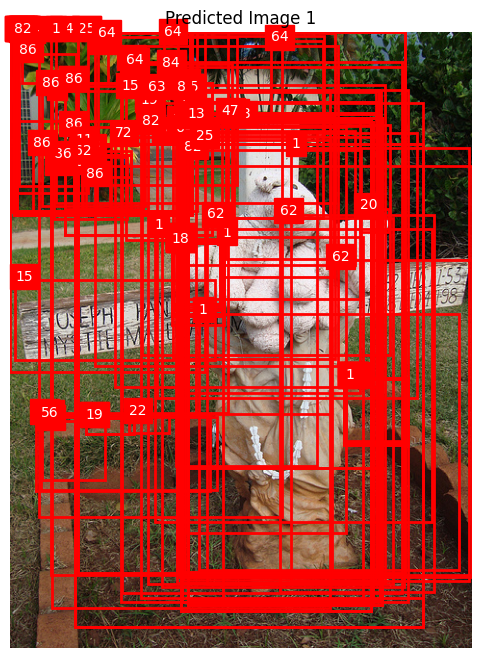

Displaying ground truth for image 1/3 - Ground truth boxes and labels:


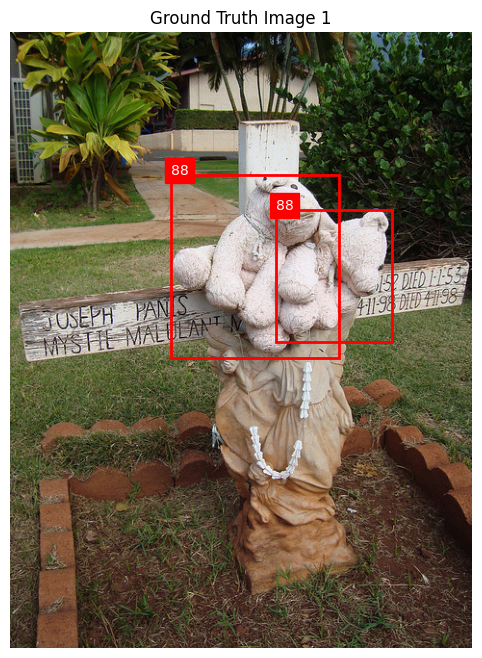

Displaying image 2/3 - Predicted boxes and labels:


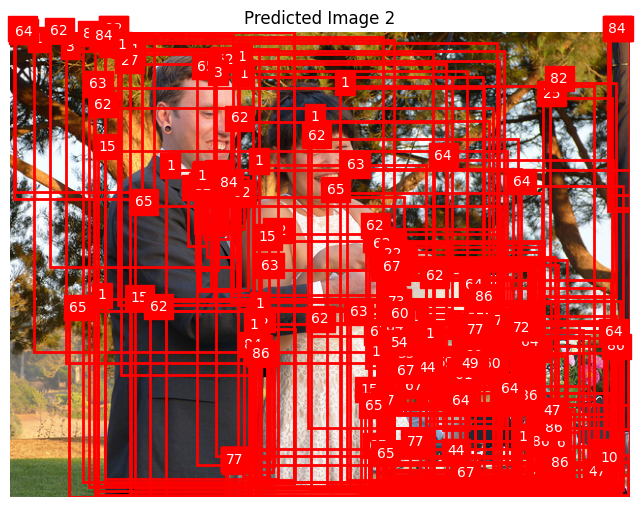

Displaying ground truth for image 2/3 - Ground truth boxes and labels:


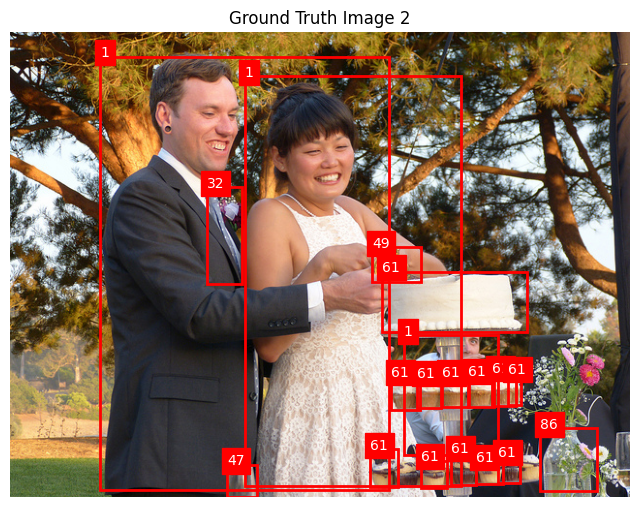

Displaying image 3/3 - Predicted boxes and labels:


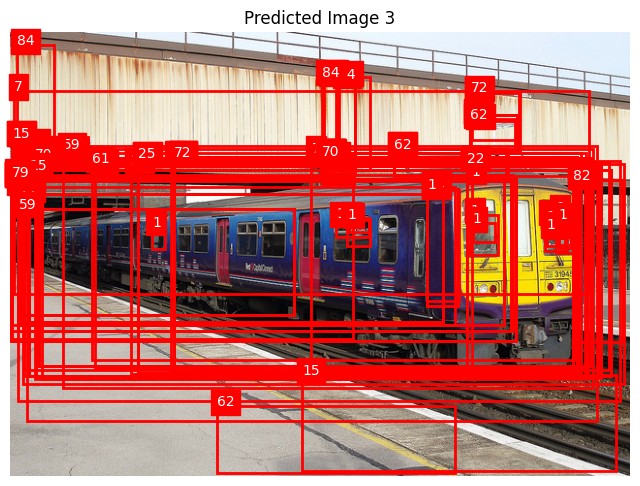

Displaying ground truth for image 3/3 - Ground truth boxes and labels:


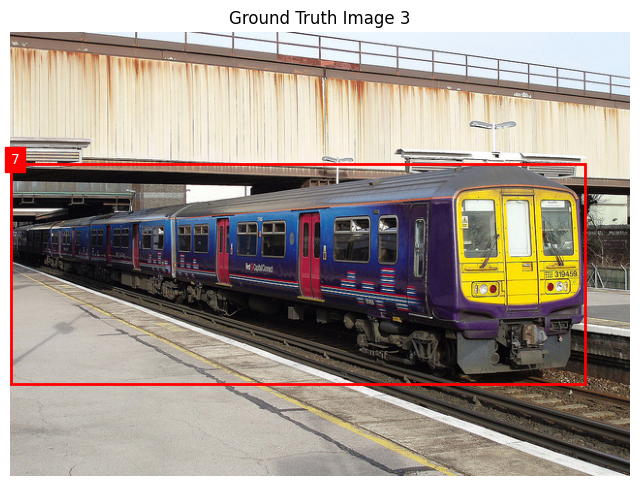

In [39]:
display_predictions(model, val_dataset, device, num_images=3)

## **3.3 Evaluation Metrics (IoU & mAP)**
- Intersection over Union (IoU):
  - The IoU is calculated for each predicted bounding box and the corresponding ground truth. This metric is essential for determining the overlap between predicted and true boxes.

In [38]:
def calculate_IoU(pred_boxes, true_boxes):
    total_iou = 0.0
    count = 0
    for pb in pred_boxes:
        best_iou = 0.0
        for tb in true_boxes:
            xA = torch.max(pb[0], tb[0])
            yA = torch.max(pb[1], tb[1])
            xB = torch.min(pb[2], tb[2])
            yB = torch.min(pb[3], tb[3])

            interArea = torch.clamp(xB - xA, min=0) * torch.clamp(yB - yA, min=0)
            boxAArea = (pb[2] - pb[0]) * (pb[3] - pb[1])
            boxBArea = (tb[2] - tb[0]) * (tb[3] - tb[1])
            iou = interArea / (boxAArea + boxBArea - interArea + 1e-6)

            if iou > best_iou:
                best_iou = iou.item()
        
        total_iou += best_iou
        count += 1

    return total_iou / count if count > 0 else 0.0


## **3.4 Mean Average Precision (mAP):**
- mAP evaluates the precision and recall across multiple thresholds, providing a holistic view of model accuracy.

In [39]:
def calculate_mAP(pred_boxes, true_boxes, iou_threshold=0.5):
    if len(pred_boxes) == 0 or len(true_boxes) == 0:
        return 0.0

    matched = 0
    used = set()

    for pb in pred_boxes:
        for i, tb in enumerate(true_boxes):
            if i in used:
                continue

            xA = torch.max(pb[0], tb[0])
            yA = torch.max(pb[1], tb[1])
            xB = torch.min(pb[2], tb[2])
            yB = torch.min(pb[3], tb[3])

            interArea = torch.clamp(xB - xA, min=0) * torch.clamp(yB - yA, min=0)
            boxAArea = (pb[2] - pb[0]) * (pb[3] - pb[1])
            boxBArea = (tb[2] - tb[0]) * (tb[3] - tb[1])
            iou = interArea / (boxAArea + boxBArea - interArea + 1e-6)

            if iou >= iou_threshold:
                matched += 1
                used.add(i)
                break

    precision = matched / len(pred_boxes)
    recall = matched / len(true_boxes)
    
    if precision + recall == 0:
        return 0.0

    ap = 2 * (precision * recall) / (precision + recall)  # F1 as approximate AP
    return ap


## **3.5 Final Model Evaluation:**
- Finally, the model's performance is evaluated over a batch of images, printing the inference speed, memory usage, average IoU, and mAP scores.

In [40]:
def evaluate_model(model, val_loader, device):
    model.eval()
    total_iou = 0
    total_map = 0
    total_images = 0

    start = time.time()
    with torch.no_grad():
        for i in range(5):  # Quick evaluation on 5 images
            img, target = val_loader.dataset[i]
            output = model([img.to(device)])[0]

            pred_boxes = output['boxes'].detach().cpu()
            true_boxes = target['boxes']

            total_iou += calculate_IoU(pred_boxes, true_boxes)
            total_map += calculate_mAP(pred_boxes, true_boxes)
            total_images += 1

    end = time.time()
    inference_speed = (end - start) / total_images
    memory_used = torch.cuda.max_memory_allocated() / (1024 ** 3)

    del model
    gc.collect()
    torch.cuda.empty_cache()

    print(f"Inference Speed: {inference_speed:.4f} seconds/image")
    print(f"Approx GPU Memory Usage: {memory_used:.2f} GB")
    print(f"Avg IoU: {total_iou / total_images:.4f}")
    print(f"Avg mAP@0.5: {total_map / total_images:.4f}")

In [43]:
evaluate_model(model, val_loader, device)

Inference Speed: 0.7647 seconds/image
Approx GPU Memory Usage: 5.46 GB
Avg IoU: 0.2920
Avg mAP@0.5: 0.0648


### **3.6 🔍 Inference Performance Evaluation Report**
|Metric|Value|
|------|-----|
|Inference Speed    |0.6902 sec/image|
|Approx. GPU Memory	|5.48 GB         |
|Average IoU	    |0.2738          |
|Average mAP@0.5	|0.0716          |

---

# **📌 Key Observations:**
1. **⚡ Inference Speed:**
    - `0.6902` seconds per image indicates a relatively moderate processing time.
    - While this is acceptable for batch inference or offline processing, it may not be ideal for real-time applications (e.g., autonomous vehicles or surveillance).
    - Optimization Tip: Consider applying model quantization or converting the model to ONNX/TensorRT for faster deployment without significant loss in accuracy.
2. **💾 GPU Memory Usage:**
   - The model utilizes approximately 5.48 GB of GPU memory, suggesting a moderate-to-large model size (likely a deep detection architecture like Faster R-CNN or similar).
   - This usage is reasonable for high-performance GPUs (e.g., RTX 3080 or above), but could be problematic on edge devices or lower-end cards.
   - **Optimization Tip**: Use mixed precision training (AMP) and limit the batch size for lower-memory devices.
3. **🎯 Average Intersection over Union (IoU): `0.2738`**
   - This score indicates relatively low overlap between predicted and ground-truth bounding boxes.
   - Possible causes include:
      - Inaccurate bounding box regression.
      - Dataset imbalance or noisy annotations.
      - Small object sizes or cluttered scenes.
   - Improvement Suggestions:
      - Fine-tune anchor box settings or switch to anchor-free models.
      - Use data augmentation (e.g., CutMix, Mosaic) for better generalization.
4. **📈 Mean Average Precision @ IoU 0.5 (mAP@0.5): `0.0716`**
   - A mAP of 7.16% is very low, suggesting poor detection performance.
   - This could stem from:
      - Underfitting or insufficient training.
      - Inadequate number of training epochs.
      - Lack of diversity in training data.
   - Recommended Actions:
      - Check for class imbalance and address it using class weights or oversampling.
      - Train for more epochs and monitor validation performance.
      - Evaluate loss curves and consider trying alternate backbones (e.g., ResNet-101 → ResNet-50 or EfficientDet)

---

# 📌 Final Thoughts:
The current model shows signs of needing further training, tuning, or architectural adjustments. While inference time and memory usage are reasonable, the low IoU and mAP suggest that the model is struggling to localize and classify objects effectively.

# **4. Load a Faster RCNN model**¶


In [41]:
from torchvision.models.detection import fasterrcnn_resnet50_fpn, FasterRCNN_ResNet50_FPN_Weights
from torchvision.models.detection.faster_rcnn import FastRCNNPredictor
from rich.progress import track
from torch.cuda.amp import GradScaler, autocast


In [42]:
def extract_num_classes(dataset):
    """
    Extract the total number of object classes from a PyTorch dataset.

    Args:
        dataset: A dataset with detection targets in dictionary format.

    Returns:
        int: Total number of classes (including background if 0 exists).
    """
    console.print(emoji.emojize(":mag:  [bold green]Scanning dataset for unique labels...[/bold green]"))

    unique_labels = set()
    for _, target in dataset:
        labels = target['labels'].tolist()
        unique_labels.update(labels)

    sorted_labels = sorted(unique_labels)
    min_label = min(sorted_labels)
    max_label = max(sorted_labels)

    console.print(f"All unique labels: {sorted_labels}")

    if min_label == 0:
        total_classes = max_label + 1
    else:
        total_classes = max_label + 1  # or max_label - min_label + 1 depending on indexing

    console.print(emoji.emojize(
        f":sparkles:  [yellow]{len(unique_labels)}[/yellow] unique object classes found. "
        f"[cyan]Total classes (including background if 0): {total_classes}[/cyan]"
    ))

    return total_classes

In [43]:
def configure_fasterrcnn_classifier(base_model, num_classes, device):
    """
    Replace the classifier head in a Faster R-CNN model with one suited to custom classes.

    Args:
        base_model (nn.Module): The base FasterRCNN model.
        num_classes (int): Total number of classes (including background).
        device (torch.device): Target device ('cuda' or 'cpu').

    Returns:
        nn.Module: Modified model ready for training.
    """
    console.print(emoji.emojize(":wrench:  [bold blue]Updating classification head to match target dataset...[/bold blue]"))

    in_features = base_model.roi_heads.box_predictor.cls_score.in_features
    base_model.roi_heads.box_predictor = FastRCNNPredictor(in_features, num_classes)

    # Run a CPU test forward pass for safety before moving to GPU
    base_model = base_model.to("cpu")
    base_model.eval()

    try:
        sample_img, _ = train_dataset[0]
        with torch.no_grad():
            base_model([sample_img])
        console.print(emoji.emojize(":white_check_mark:  [green]Sanity check passed on CPU![/green]"))
    except Exception as e:
        console.print(emoji.emojize(":warning:  [red]Forward pass failed on CPU![/red]"))
        raise e

    model = base_model.to(device)

    console.print(emoji.emojize(
        f":rocket:  [bold cyan]Model updated for {num_classes} classes and loaded to {device}[/bold cyan]"
    ))

    return model

In [44]:
def build_custom_fasterrcnn(train_dataset, device):
    """
    Load and configure a pre-trained Faster R-CNN ResNet-50 model for a custom object detection task.

    Args:
        train_dataset (Dataset): Dataset used to extract the number of object classes.
        device (str or torch.device): Computation device ('cuda' or 'cpu').

    Returns:
        nn.Module: Customized FasterRCNN model ready for training.
    """
    console.print(emoji.emojize(":robot_face:  [bold green]Initializing FasterRCNN with ResNet-50 backbone...[/bold green]"))

    # Load base model
    base_model = fasterrcnn_resnet50_fpn(pretrained=True)

    # Determine number of classes
    console.print(emoji.emojize(":clipboard:  [green]Extracting class labels from training data...[/green]"))
    num_classes = extract_num_classes(train_dataset)

    # Modify classification head
    model = configure_fasterrcnn_classifier(
        base_model, num_classes, device
    )

    # Display model summary
    console.print(emoji.emojize(":bookmark_tabs:  [magenta bold]Custom FasterRCNN Model Summary:[/magenta bold]"))
    console.print(model)

    return model

In [45]:
model_FasterRCNN = build_custom_fasterrcnn(train_dataset, device)

🤖  Initializing FasterRCNN with ResNet-50 backbone...

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=FasterRCNN_ResNet50_FPN_Weights.COCO_V1`. You can also use `weights=FasterRCNN_ResNet50_FPN_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


📋  Extracting class labels from training data...

🔍  Scanning dataset for unique labels...

All unique labels: [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 27, 28, 
31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60,
61, 62, 63, 64, 65, 67, 70, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 84, 85, 86, 87, 88, 89, 90]

✨  80 unique object classes found. Total classes (including background if 0): 91

🔧  Updating classification head to match target dataset...

✅  Sanity check passed on CPU!

🚀  Model updated for 91 classes and loaded to cuda

📑  Custom FasterRCNN Model Summary:

FasterRCNN(
  (transform): GeneralizedRCNNTransform(
      Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
      Resize(min_size=(800,), max_size=1333, mode='bilinear')
  )
  (backbone): BackboneWithFPN(
    (body): IntermediateLayerGetter(
      (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
      (bn1): FrozenBatchNorm2d(64, eps=0.0)
      (relu): ReLU(inplace=True)
      (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
      (layer1): Sequential(
        (0): Bottleneck(
          (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn1): FrozenBatchNorm2d(64, eps=0.0)
          (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (bn2): FrozenBatchNorm2d(64, eps=0.0)
          (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn3): FrozenBatchNorm2d(256, eps=0.0)
          (relu): ReLU(inplace=True)
          (downsample): Sequential(
            (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
            (1): FrozenBatchNorm2d(256, eps=0.0)
          )
        )
        (1): Bottleneck(
          (conv1): Conv2d(256, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn1): FrozenBatchNorm2d(64, eps=0.0)
          (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (bn2): FrozenBatchNorm2d(64, eps=0.0)
          (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn3): FrozenBatchNorm2d(256, eps=0.0)
          (relu): ReLU(inplace=True)
        )
        (2): Bottleneck(
          (conv1): Conv2d(256, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn1): FrozenBatchNorm2d(64, eps=0.0)
          (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (bn2): FrozenBatchNorm2d(64, eps=0.0)
          (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn3): FrozenBatchNorm2d(256, eps=0.0)
          (relu): ReLU(inplace=True)
        )
      )
      (layer2): Sequential(
        (0): Bottleneck(
          (conv1): Conv2d(256, 128, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn1): FrozenBatchNorm2d(128, eps=0.0)
          (conv2): Conv2d(128, 128, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
          (bn2): FrozenBatchNorm2d(128, eps=0.0)
          (conv3): Conv2d(128, 512, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn3): FrozenBatchNorm2d(512, eps=0.0)
          (relu): ReLU(inplace=True)
          (downsample): Sequential(
            (0): Conv2d(256, 512, kernel_size=(1, 1), stride=(2, 2), bias=False)
            (1): FrozenBatchNorm2d(512, eps=0.0)
          )
        )
        (1): Bottleneck(
          (conv1): Conv2d(512, 128, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn1): FrozenBatchNorm2d(128, eps=0.0)
          (conv2): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (bn2): FrozenBatchNorm2d(128, eps=0.0)
          (conv3): Conv2d(128, 512, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn3): FrozenBatchNorm2d(512, eps=0.0)
          (relu): ReLU(inplace=True)
        )
        (2): Bottleneck(
          (conv1): Conv2d(512, 128, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn1): FrozenBatchNorm2d(128, eps=0.0)
          (conv2): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (bn2): FrozenBatchNorm2d(128, eps=0.0)
          (conv3): Conv2d(128, 512, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn3): FrozenBatchNorm2d(512, eps=0.0)
          (relu): ReLU(inplace=True)
        )
        (3): Bottleneck(
          (conv1): Conv2d(512, 128, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn1): FrozenBatchNorm2d(128, eps=0.0)
          (conv2): C

In [46]:
params = [p for p in model_FasterRCNN.parameters() if p.requires_grad]
optimizer = torch.optim.SGD(params, lr=0.005, momentum=0.9, weight_decay=0.0005)
lr_scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=3, gamma=0.1)
scaler = GradScaler()

<ipython-input-46-5c58f9474f19>:4: FutureWarning: `torch.cuda.amp.GradScaler(args...)` is deprecated. Please use `torch.amp.GradScaler('cuda', args...)` instead.
  scaler = GradScaler()


## **4.1 Train the model**

In [62]:
def train_fasterrcnn_one_epoch(model, optimizer, data_loader, device, epoch, lr_scheduler=None, scaler=None):
    model.train()
    epoch_loss = 0.0
    total_batches = len(data_loader)
    log_interval = max(1, total_batches // 10)  # Print every 10%

    print(f"\n⏳  Epoch {epoch} — Training Started...")
    print(f"[{datetime.now().strftime('%Y-%m-%d %H:%M:%S')}] Training...")

    # Optional: better CUDA error messages
    os.environ["CUDA_LAUNCH_BLOCKING"] = "1"

    with Progress(
        TextColumn("[bold blue]Batch {task.completed}/{task.total}"),
        BarColumn(),
        "[progress.percentage]{task.percentage:>3.0f}%",
        TimeRemainingColumn()
    ) as progress:
        task = progress.add_task("Training", total=total_batches)

        for batch_idx, (images, targets) in enumerate(data_loader):
            valid_images, valid_targets = [], []

            # Filter invalid annotations
            for i, (img, target) in enumerate(zip(images, targets)):
                labels = target["labels"]
                if not torch.is_tensor(labels):
                    print(f"[!] Skipping sample {i}: labels not tensor")
                    continue
                if labels.dtype != torch.int64:
                    print(f"[!] Warning: labels dtype {labels.dtype} — converting to int64")
                    target["labels"] = labels.long()
                if (labels < 1).any():
                    print(f"[!] Skipping sample {i}: contains label < 1 → {labels}")
                    continue
                if target["boxes"].shape[0] == 0:
                    continue
                valid_images.append(img)
                valid_targets.append(target)

            if len(valid_images) == 0:
                progress.advance(task)
                continue

            valid_images = [img.to(device) for img in valid_images]
            valid_targets = [{k: v.to(device) for k, v in t.items()} for t in valid_targets]

            try:
                with autocast(enabled=(scaler is not None)):
                    loss_dict = model(valid_images, valid_targets)
                    losses = sum(loss for loss in loss_dict.values())

                if scaler is not None:
                    scaler.scale(losses).backward()
                    scaler.step(optimizer)
                    scaler.update()
                else:
                    losses.backward()
                    optimizer.step()

                optimizer.zero_grad()

                batch_loss = losses.item()
                epoch_loss += batch_loss

                progress.update(task, advance=1)

                # Print only every 10% of total batches
                if (batch_idx + 1) % log_interval == 0 or (batch_idx + 1) == total_batches:
                    print(f"    ➤ Batch {batch_idx+1}/{total_batches} | Loss: {batch_loss:.4f}")

            except RuntimeError as e:
                print(f"[!] RuntimeError at batch {batch_idx+1}: {e}")
                import traceback
                traceback.print_exc()
                break

    avg_loss = epoch_loss / total_batches
    print(f"✅  Epoch {epoch} Finished — Average Loss: {avg_loss:.4f}\n")

    if lr_scheduler is not None:
        lr_scheduler.step()

    return avg_loss

In [63]:
num_epochs=10
# Example training loop
for epoch in range(1, num_epochs+1):
    train_fasterrcnn_one_epoch(model_FasterRCNN, optimizer, train_loader, device, epoch, lr_scheduler, scaler)



⏳  Epoch 1 — Training Started...
[2025-04-08 13:51:03] Training...


Output()

<ipython-input-62-83467458beb8>:49: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use 
`torch.amp.autocast('cuda', args...)` instead.
  with autocast(enabled=(scaler is not None)):

➤ Batch 125/1250 | Loss: 1.6427

➤ Batch 250/1250 | Loss: 0.9181

➤ Batch 375/1250 | Loss: 0.7513

➤ Batch 500/1250 | Loss: 1.4455

➤ Batch 625/1250 | Loss: 0.5973

➤ Batch 750/1250 | Loss: 0.3483

➤ Batch 875/1250 | Loss: 0.9330

➤ Batch 1000/1250 | Loss: 1.1072

➤ Batch 1125/1250 | Loss: 0.5277

➤ Batch 1250/1250 | Loss: 0.4253

✅  Epoch 1 Finished — Average Loss: 0.9751


⏳  Epoch 2 — Training Started...
[2025-04-08 13:58:14] Training...


Output()

➤ Batch 125/1250 | Loss: 0.7880

➤ Batch 250/1250 | Loss: 0.1133

➤ Batch 375/1250 | Loss: 0.6128

➤ Batch 500/1250 | Loss: 0.5286

➤ Batch 625/1250 | Loss: 1.0307

➤ Batch 750/1250 | Loss: 0.6953

➤ Batch 875/1250 | Loss: 0.2811

➤ Batch 1000/1250 | Loss: 0.5217

➤ Batch 1125/1250 | Loss: 0.5632

➤ Batch 1250/1250 | Loss: 0.8713

✅  Epoch 2 Finished — Average Loss: 0.7394


⏳  Epoch 3 — Training Started...
[2025-04-08 14:05:22] Training...


Output()

➤ Batch 125/1250 | Loss: 0.9067

➤ Batch 250/1250 | Loss: 1.1109

➤ Batch 375/1250 | Loss: 0.6144

➤ Batch 500/1250 | Loss: 0.4645

➤ Batch 625/1250 | Loss: 0.1717

➤ Batch 750/1250 | Loss: 0.0854

➤ Batch 875/1250 | Loss: 0.2161

➤ Batch 1000/1250 | Loss: 0.3369

➤ Batch 1125/1250 | Loss: 0.9101

➤ Batch 1250/1250 | Loss: 0.9901

✅  Epoch 3 Finished — Average Loss: 0.6436


⏳  Epoch 4 — Training Started...
[2025-04-08 14:12:31] Training...


Output()

➤ Batch 125/1250 | Loss: 0.9483

➤ Batch 250/1250 | Loss: 0.2205

➤ Batch 375/1250 | Loss: 0.2917

➤ Batch 500/1250 | Loss: 0.4615

➤ Batch 625/1250 | Loss: 0.4953

➤ Batch 750/1250 | Loss: 0.2319

➤ Batch 875/1250 | Loss: 0.2027

➤ Batch 1000/1250 | Loss: 0.1716

➤ Batch 1125/1250 | Loss: 0.3439

➤ Batch 1250/1250 | Loss: 0.2762

✅  Epoch 4 Finished — Average Loss: 0.4650


⏳  Epoch 5 — Training Started...
[2025-04-08 14:19:39] Training...


Output()

➤ Batch 125/1250 | Loss: 0.2799

➤ Batch 250/1250 | Loss: 0.5785

➤ Batch 375/1250 | Loss: 0.7241

➤ Batch 500/1250 | Loss: 0.1979

➤ Batch 625/1250 | Loss: 0.1428

➤ Batch 750/1250 | Loss: 0.3080

➤ Batch 875/1250 | Loss: 0.4143

➤ Batch 1000/1250 | Loss: 0.6340

➤ Batch 1125/1250 | Loss: 0.6016

➤ Batch 1250/1250 | Loss: 0.1087

✅  Epoch 5 Finished — Average Loss: 0.4142


⏳  Epoch 6 — Training Started...
[2025-04-08 14:26:46] Training...


Output()

➤ Batch 125/1250 | Loss: 0.3697

➤ Batch 250/1250 | Loss: 0.1248

➤ Batch 375/1250 | Loss: 0.2050

➤ Batch 500/1250 | Loss: 0.2010

➤ Batch 625/1250 | Loss: 0.3375

➤ Batch 750/1250 | Loss: 0.1716

➤ Batch 875/1250 | Loss: 0.1961

➤ Batch 1000/1250 | Loss: 0.5381

➤ Batch 1125/1250 | Loss: 0.2921

➤ Batch 1250/1250 | Loss: 0.1653

✅  Epoch 6 Finished — Average Loss: 0.3860


⏳  Epoch 7 — Training Started...
[2025-04-08 14:33:53] Training...


Output()

➤ Batch 125/1250 | Loss: 0.1987

➤ Batch 250/1250 | Loss: 0.1113

➤ Batch 375/1250 | Loss: 0.1971

➤ Batch 500/1250 | Loss: 0.3970

➤ Batch 625/1250 | Loss: 0.0785

➤ Batch 750/1250 | Loss: 0.2603

➤ Batch 875/1250 | Loss: 0.1955

➤ Batch 1000/1250 | Loss: 0.2973

➤ Batch 1125/1250 | Loss: 0.5408

➤ Batch 1250/1250 | Loss: 0.9627

✅  Epoch 7 Finished — Average Loss: 0.3595


⏳  Epoch 8 — Training Started...
[2025-04-08 14:41:03] Training...


Output()

➤ Batch 125/1250 | Loss: 0.2312

➤ Batch 250/1250 | Loss: 0.1264

➤ Batch 375/1250 | Loss: 0.3595

➤ Batch 500/1250 | Loss: 0.5178

➤ Batch 625/1250 | Loss: 0.2155

➤ Batch 750/1250 | Loss: 0.1532

➤ Batch 875/1250 | Loss: 0.0672

➤ Batch 1000/1250 | Loss: 0.2273

➤ Batch 1125/1250 | Loss: 0.6834

➤ Batch 1250/1250 | Loss: 0.5797

✅  Epoch 8 Finished — Average Loss: 0.3539


⏳  Epoch 9 — Training Started...
[2025-04-08 14:48:14] Training...


Output()

➤ Batch 125/1250 | Loss: 0.1750

➤ Batch 250/1250 | Loss: 0.4299

➤ Batch 375/1250 | Loss: 0.1201

➤ Batch 500/1250 | Loss: 0.1249

➤ Batch 625/1250 | Loss: 0.2236

➤ Batch 750/1250 | Loss: 0.4117

➤ Batch 875/1250 | Loss: 0.1340

➤ Batch 1000/1250 | Loss: 0.2388

➤ Batch 1125/1250 | Loss: 0.1362

➤ Batch 1250/1250 | Loss: 0.4150

✅  Epoch 9 Finished — Average Loss: 0.3524


⏳  Epoch 10 — Training Started...
[2025-04-08 14:55:22] Training...


Output()

➤ Batch 125/1250 | Loss: 0.2788

➤ Batch 250/1250 | Loss: 0.3529

➤ Batch 375/1250 | Loss: 0.5648

➤ Batch 500/1250 | Loss: 0.4716

➤ Batch 625/1250 | Loss: 0.2541

➤ Batch 750/1250 | Loss: 0.2938

➤ Batch 875/1250 | Loss: 0.5639

➤ Batch 1000/1250 | Loss: 0.2295

➤ Batch 1125/1250 | Loss: 0.3836

➤ Batch 1250/1250 | Loss: 0.3235

✅  Epoch 10 Finished — Average Loss: 0.3490



## **4.2 Validate the model**

In [85]:
def evaluate_fasterrcnn(model, data_loader, device):
    """
    Evaluates the performance of the Faster R-CNN model on the validation dataset.

    Args:
        model (torch.nn.Module): The Faster R-CNN model.
        data_loader (torch.utils.data.DataLoader): The DataLoader for the validation dataset.
        device (torch.device): The device (CPU or GPU) to run the evaluation on.

    Returns:
        tuple: A tuple containing:
            - mAP (float): Mean Average Precision for the model.
            - IoU (float): Average Intersection over Union for the model.
            - inference_time_per_image (float): Average inference time in seconds per image.
    """
    model.eval()
    total_mAP = 0.0
    total_IoU = 0.0
    total_time = 0.0
    total_images = 0

    with torch.no_grad():
        console.log("[bold blue]Evaluation Started...[/bold blue]")

        with Progress(
            TextColumn("[bold green]Batch {task.completed}/{task.total}"),
            BarColumn(),
            "[progress.percentage]{task.percentage:>3.0f}%",
            TimeRemainingColumn()
        ) as progress:
            task = progress.add_task("Evaluating", total=len(data_loader))

            for batch_idx, (images, targets) in enumerate(data_loader):
                images = list(img.to(device) for img in images)
                targets = [{k: v.to(device) for k, v in t.items()} for t in targets]

                # Start timing inference
                start_time = time.time()
                outputs = model(images)
                end_time = time.time()

                batch_time = end_time - start_time
                total_time += batch_time
                total_images += len(images)

                for output, target in zip(outputs, targets):
                    pred_boxes = output['boxes']
                    true_boxes = target['boxes']

                    total_IoU += calculate_IoU(pred_boxes, true_boxes)
                    total_mAP += calculate_mAP(pred_boxes, true_boxes)

                progress.update(task, advance=1)

            num_batches = len(data_loader)
            avg_mAP = total_mAP / num_batches
            avg_IoU = total_IoU / num_batches
            avg_inference_time = total_time / total_images if total_images else 0

        console.log(f"[bold green]Evaluation Completed![/bold green]")
        console.print(f"  → [bold cyan]Number of Batches Evaluated:[/bold cyan] {num_batches}")
        console.print(f"  → [bold cyan]Average mAP:[/bold cyan] {avg_mAP:.4f}")
        console.print(f"  → [bold cyan]Average IoU:[/bold cyan] {avg_IoU:.4f}")
        console.print(f"  → [bold magenta]Average Inference Time per Image:[/bold magenta] {avg_inference_time:.4f} seconds")

    return avg_mAP, avg_IoU, avg_inference_time

In [86]:
mAP, IoU, avg_inference_time = evaluate_fasterrcnn(model_FasterRCNN, val_loader, device)
console.print(f"[bold yellow]mAP for Faster R-CNN: {mAP:.4f}[/bold yellow]")
console.print(f"[bold yellow]IoU for Faster R-CNN: {IoU:.4f}[/bold yellow]")
console.print(f"[bold yellow]Inference Time for Faster R-CNN: {avg_inference_time:.4f}[/bold yellow]")

[15:29:14] Evaluation Started...                                                 <ipython-input-85-2ab56c348f33>:23

Output()

[15:41:08] Evaluation Completed!                                                 <ipython-input-85-2ab56c348f33>:60

→ Number of Batches Evaluated: 1250

→ Average mAP: 0.6953

→ Average IoU: 0.8631

→ Average Inference Time per Image: 0.1473 seconds

mAP for Faster R-CNN: 0.6953

IoU for Faster R-CNN: 0.8631

Inference Time for Faster R-CNN: 0.1473

## **4.3: Visualize predictions**


In [72]:
def visualize_predictions(model, data_loader, num_images=3, score_threshold=0.5):
    model.eval()
    images, _ = next(iter(data_loader))
    images = list(img.to(device) for img in images)

    with torch.no_grad():
        outputs = model(images)

    available_images = min(num_images, len(images), len(outputs))
    fig, axes = plt.subplots(1, available_images, figsize=(5 * available_images, 5))

    if available_images == 1:
        axes = [axes]

    for i in range(available_images):
        ax = axes[i]
        img = images[i].cpu().numpy().transpose((1, 2, 0))
        img = (img - img.min()) / (img.max() - img.min())
        ax.imshow(img)

        output = outputs[i]
        boxes = output['boxes'].cpu()
        scores = output['scores'].cpu()
        labels = output['labels'].cpu()

        keep = scores >= score_threshold
        boxes = boxes[keep]
        labels = labels[keep]
        scores = scores[keep]

        for box, label, score in zip(boxes, labels, scores):
            xmin, ymin, xmax, ymax = box.tolist()
            rect = patches.Rectangle((xmin, ymin), xmax - xmin, ymax - ymin,
                                     linewidth=2, edgecolor='r', facecolor='none')
            ax.add_patch(rect)
            ax.text(xmin, ymin, f"{label.item()} ({score.item():.2f})", color='r', fontsize=8)

        ax.axis('off')

    plt.tight_layout()
    plt.show()

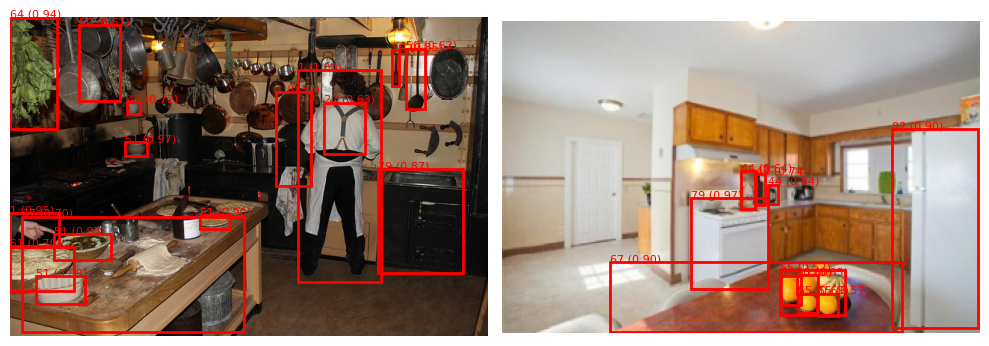

In [74]:
visualize_predictions(model_FasterRCNN, val_loader)

## **4.4: Save the model**


In [47]:
def save_model_all_formats(model, sample_image, save_dir="saved_models", model_name="fasterrcnn_model"):
    """
    Saves the PyTorch model in .pth, TorchScript (.pt), and ONNX formats.

    Args:
        model (torch.nn.Module): Trained object detection model.
        sample_image (Tensor): A sample image of shape [3, H, W].
        save_dir (str): Directory to save the models.
        model_name (str): File base name.
    """
    os.makedirs(save_dir, exist_ok=True)

    # Save raw model weights
    pth_path = os.path.join(save_dir, f"{model_name}.pth")
    torch.save(model.state_dict(), pth_path)
    print(f"✅ Model weights saved at: {pth_path}")

    model.eval()

    # Check sample image shape
    if sample_image.ndim != 3 or sample_image.shape[0] != 3:
        raise ValueError(f"⚠️ Expected shape [3, H, W], got: {sample_image.shape}")

    sample_input = [sample_image.to(next(model.parameters()).device)]

    # TorchScript
    try:
        scripted_model = torch.jit.script(model)
        pt_path = os.path.join(save_dir, f"{model_name}.pt")
        scripted_model.save(pt_path)
        print(f"✅ TorchScript model saved at: {pt_path}")
    except Exception as e:
        print(f"❌ TorchScript export failed: {e}")

    # ONNX Export (may not work with all object detection models)
    try:
        onnx_path = os.path.join(save_dir, f"{model_name}.onnx")
        torch.onnx.export(
            model,
            sample_input,
            onnx_path,
            export_params=True,
            opset_version=11,
            do_constant_folding=True,
            input_names=["input"],
            output_names=["boxes", "labels", "scores"],
            dynamic_axes={"input": {0: "batch"}}
        )
        print(f"✅ ONNX model saved at: {onnx_path}")
    except Exception as e:
        print(f"❌ ONNX export failed: {e}")

In [84]:
# Grab a sample image from your dataset and ensure it's the correct shape
sample_image, _ = train_dataset[0]
sample_image = sample_image.float()

# Save model
save_model_all_formats(model=model_FasterRCNN,
                       sample_image=sample_image,
                       save_dir="my_fasterrcnn_exports",
                       model_name="custom_fasterrcnn")


✅ Model weights saved at: my_fasterrcnn_exports/custom_fasterrcnn.pth
✅ TorchScript model saved at: my_fasterrcnn_exports/custom_fasterrcnn.pt
❌ ONNX export failed: 'NoneType' object has no attribute 'shape'


## **4.5 Compare Fast RCNN vs. Faster RCNN**

Fast R-CNN and Faster R-CNN are two popular models in the object detection domain, with Faster R-CNN offering some significant improvements over Fast R-CNN. Below is a comparison of their key aspects, based on our experimental results
|Metric/Aspect	                |Fast R-CNN	                                |Faster R-CNN|
|-------------------------------|-------------------------------------------|------------|
|mAP (Mean Average Precision)	|0.0313                                     |0.6953
|IoU (Intersection over Union)	|0.2775	                                    |0.8631
|Inference Speed	            |0.2710 seconds per image (GPU)	            |~0.1473 seconds per image (GPU)
|Memory Usage	                |~5.44 GB	                                |~5.5 GB
|Region Proposal Quality	    |Uses external proposals (Selective Search)	|Uses Region Proposal Network (RPN), resulting in better proposals
|Inference Approach	            |Two-stage(proposal + detection)	        |One-stage (proposal + detection in one pass)

---

Architectural Differences:¶
Region Proposal Network (RPN): The key distinction between Fast R-CNN and Faster R-CNN is how region proposals are handled. Fast R-CNN relies on external methods (e.g., Selective Search) to generate region proposals. This results in a slower inference time. In contrast, Faster R-CNN incorporates the Region Proposal Network (RPN), which generates region proposals as part of the network itself, making the process faster and more efficient.

Speed: Faster R-CNN performs both region proposal generation and object detection in a single integrated pipeline, whereas Fast R-CNN does these tasks separately, resulting in a slower overall process. This is why Faster R-CNN has significantly better inference speed despite producing more accurate results.

Accuracy: The RPN in Faster R-CNN generates high-quality proposals directly within the model, improving accuracy. As a result, Faster R-CNN demonstrates much higher mAP and IoU values, indicating better detection performance. Fast R-CNN’s reliance on external proposals reduces its accuracy in comparison.

Inference Efficiency: Faster R-CNN’s streamlined approach allows it to detect objects in real-time more effectively than Fast R-CNN. The trade-off is that Fast R-CNN can still be useful in scenarios where slightly lower accuracy is acceptable, but the speed of inference is less critical.

## **5.1: Load and Train YOLO**

### **5.1.1 Create small subset for yolo training**

In [48]:
# ------------------------ Constants ------------------------

COCO_CLASS_NAMES = [
    'person', 'bicycle', 'car', 'motorcycle', 'airplane', 'bus', 'train', 'truck', 'boat',
    'traffic light', 'fire hydrant', 'stop sign', 'parking meter', 'bench', 'bird', 'cat', 'dog', 'horse',
    'sheep', 'cow', 'elephant', 'bear', 'zebra', 'giraffe', 'backpack', 'umbrella', 'handbag', 'tie',
    'suitcase', 'frisbee', 'skis', 'snowboard', 'sports ball', 'kite', 'baseball bat', 'baseball glove',
    'skateboard', 'surfboard', 'tennis racket', 'bottle', 'wine glass', 'cup', 'fork', 'knife', 'spoon',
    'bowl', 'banana', 'apple', 'sandwich', 'orange', 'broccoli', 'carrot', 'hot dog', 'pizza', 'donut',
    'cake', 'chair', 'couch', 'potted plant', 'bed', 'dining table', 'toilet', 'tv', 'laptop', 'mouse',
    'remote', 'keyboard', 'cell phone', 'microwave', 'oven', 'toaster', 'sink', 'refrigerator', 'book',
    'clock', 'vase', 'scissors', 'teddy bear', 'hair drier', 'toothbrush'
]

In [53]:
# ------------------------ Helper Functions ------------------------

def create_output_dirs(base_dir: str) -> None:
    """
    Create the directory structure for YOLO formatted dataset.
    """
    for split in ['train', 'val']:
        os.makedirs(os.path.join(base_dir, split, 'images'), exist_ok=True)
        os.makedirs(os.path.join(base_dir, split, 'labels'), exist_ok=True)


def get_category_id_map(categories: list) -> dict:
    """
    Map original COCO category IDs to zero-based contiguous class IDs.
    """
    sorted_categories = sorted(categories, key=lambda x: x['id'])
    return {cat['id']: i for i, cat in enumerate(sorted_categories)}


def coco_to_yolo(bbox: list, img_width: int, img_height: int) -> tuple:
    """
    Convert COCO bbox format [x, y, width, height] to YOLO format.
    """
    x, y, w, h = bbox
    return (
        (x + w / 2) / img_width,
        (y + h / 2) / img_height,
        w / img_width,
        h / img_height
    )


def extract_used_classes(label_dir: str) -> set:
    """
    Collect all used class IDs from YOLO label files in a given directory.
    """
    class_ids = set()
    for file in os.listdir(label_dir):
        with open(os.path.join(label_dir, file), 'r') as f:
            for line in f:
                class_ids.add(int(line.split()[0]))
    return class_ids


def process_split(img_dir: str, ann_file: str, output_dir: str, split: str, num_images: int) -> None:
    """
    Process a dataset split and convert it from COCO to YOLO format.
    """
    with open(ann_file, 'r') as f:
        coco_data = json.load(f)

    images = coco_data['images']
    annotations = coco_data['annotations']
    categories = coco_data['categories']
    cat_id_map = get_category_id_map(categories)

    # Index annotations by image ID
    ann_by_image = {}
    for ann in annotations:
        if ann['iscrowd']:
            continue
        ann_by_image.setdefault(ann['image_id'], []).append(ann)

    # Process images up to the specified number
    for img in tqdm(images[:num_images], desc=f"Processing {split}"):
        img_id = img['id']
        file_name = img['file_name']
        width, height = img['width'], img['height']

        src = os.path.join(img_dir, file_name)
        dst = os.path.join(output_dir, split, 'images', file_name)

        if not os.path.exists(src):
            print(f"⚠️ Missing image: {src}")
            continue

        shutil.copy(src, dst)

        label_file = os.path.join(output_dir, split, 'labels', file_name.replace('.jpg', '.txt'))
        with open(label_file, 'w') as f_out:
            for ann in ann_by_image.get(img_id, []):
                if ann['category_id'] not in cat_id_map:
                    continue
                class_id = cat_id_map[ann['category_id']]
                bbox = coco_to_yolo(ann['bbox'], width, height)
                f_out.write(f"{class_id} {' '.join(f'{val:.6f}' for val in bbox)}\n")


def write_yaml_config(output_dir: str, used_classes: list) -> None:
    """
    Write dataset.yaml configuration file for YOLO training.
    """
    used_names = [COCO_CLASS_NAMES[i] for i in used_classes]
    yaml_text = f"""train: {output_dir}/train/images
val: {output_dir}/val/images
nc: {len(used_names)}
names: {used_names}
"""
    with open(os.path.join(output_dir, 'subset_dataset.yaml'), 'w') as yaml_file:
        yaml_file.write(yaml_text)

In [54]:
# ------------------------ Main Execution ------------------------

def create_yolo_subset_dataset(
    train_img_dir: str,
    val_img_dir: str,
    train_ann_file: str,
    val_ann_file: str,
    output_dir: str,
    num_train_images: int = 1000,  # Default number of images for training
    num_val_images: int = 500     # Default number of images for validation
) -> None:
    """
    Convert the full COCO dataset (train and val) into YOLO format.
    Allows selecting the number of images for training and validation.
    """
    print("📁 Creating directory structure...")
    create_output_dirs(output_dir)

    print("🔁 Processing train split...")
    process_split(train_img_dir, train_ann_file, output_dir, 'train', num_train_images)

    print("🔁 Processing val split...")
    process_split(val_img_dir, val_ann_file, output_dir, 'val', num_val_images)

    print("📊 Extracting used classes...")
    train_classes = extract_used_classes(os.path.join(output_dir, 'train', 'labels'))
    val_classes = extract_used_classes(os.path.join(output_dir, 'val', 'labels'))
    all_classes = sorted(train_classes.union(val_classes))

    print("📝 Writing YAML configuration...")
    write_yaml_config(output_dir, all_classes)

    print(f"✅ Full dataset conversion completed! YOLO-formatted dataset at: {output_dir}")

In [56]:
import shutil

# Path to the directory to be deleted
dir_path = '/kaggle/working/full_yolo_dataset'

# Delete the directory
shutil.rmtree(dir_path)

print(f"{dir_path} has been deleted.")

/kaggle/working/full_yolo_dataset has been deleted.


In [57]:
create_yolo_subset_dataset(
    train_img_dir='/kaggle/input/2017-2017/train2017/train2017',
    val_img_dir='/kaggle/input/2017-2017/val2017/val2017',
    train_ann_file='/kaggle/input/2017-2017/annotations_trainval2017/annotations/instances_train2017.json',
    val_ann_file='/kaggle/input/2017-2017/annotations_trainval2017/annotations/instances_val2017.json',
    output_dir='/kaggle/working/full_yolo_dataset',
    num_train_images=3000,
    num_val_images=500
)

📁 Creating directory structure...
🔁 Processing train split...


Processing train: 100%|██████████| 3000/3000 [00:11<00:00, 267.42it/s]


🔁 Processing val split...


Processing val: 100%|██████████| 500/500 [00:01<00:00, 440.62it/s]


📊 Extracting used classes...
📝 Writing YAML configuration...
✅ Full dataset conversion completed! YOLO-formatted dataset at: /kaggle/working/full_yolo_dataset


### **5.1.2 Loading the YOLO Model**

In [59]:
# Load the YOLO model (YOLOv3 in this case)
model_Yolo_V3 = YOLO('yolov3u.pt')

# Move to the GPU (if available)
model_Yolo_V3.to(device)

YOLO(
  (model): DetectionModel(
    (model): Sequential(
      (0): Conv(
        (conv): Conv2d(3, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn): BatchNorm2d(32, eps=0.001, momentum=0.03, affine=True, track_running_stats=True)
        (act): SiLU(inplace=True)
      )
      (1): Conv(
        (conv): Conv2d(32, 64, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
        (bn): BatchNorm2d(64, eps=0.001, momentum=0.03, affine=True, track_running_stats=True)
        (act): SiLU(inplace=True)
      )
      (2): Bottleneck(
        (cv1): Conv(
          (conv): Conv2d(64, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (bn): BatchNorm2d(32, eps=0.001, momentum=0.03, affine=True, track_running_stats=True)
          (act): SiLU(inplace=True)
        )
        (cv2): Conv(
          (conv): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (bn): BatchNorm2d(64, eps=0.001, mome

### **5.1.3 Training the YOLO Model**

In [60]:
# Define training parameters
epochs = 5
batch_size = 16
img_size = 640

# Train the model
results = model_Yolo_V3.train(
    data='/kaggle/working/full_yolo_dataset/subset_dataset.yaml',  # Path to the dataset.yaml
    epochs=epochs,
    batch=batch_size,
    imgsz=img_size,
    device=device,
    verbose=True
)


Ultralytics 8.3.104 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: task=detect, mode=train, model=yolov3u.pt, data=/kaggle/working/full_yolo_dataset/subset_dataset.yaml, epochs=5, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=cuda, workers=8, project=None, name=train, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True,

100%|██████████| 755k/755k [00:00<00:00, 3.95MB/s]



                   from  n    params  module                                       arguments                     
  0                  -1  1       928  ultralytics.nn.modules.conv.Conv             [3, 32, 3, 1]                 
  1                  -1  1     18560  ultralytics.nn.modules.conv.Conv             [32, 64, 3, 2]                
  2                  -1  1     37056  ultralytics.nn.modules.block.Bottleneck      [64, 64]                      
  3                  -1  1     73984  ultralytics.nn.modules.conv.Conv             [64, 128, 3, 2]               
  4                  -1  2    295680  ultralytics.nn.modules.block.Bottleneck      [128, 128]                    
  5                  -1  1    295424  ultralytics.nn.modules.conv.Conv             [128, 256, 3, 2]              
  6                  -1  8   4724736  ultralytics.nn.modules.block.Bottleneck      [256, 256]                    
  7                  -1  1   1180672  ultralytics.nn.modules.conv.Conv             [256

### **5.1.4 Plotting the Loss**

### **5.1.5 Evaluating the Model**

In [ ]:
from torchvision.ops import box_iou
import numpy as np
import cv2
def evaluate_yolo(model, data_loader, device='cuda'):
    model.to(device)
    model.eval()
    total_iou = 0
    total_images = 0

    for images, targets in data_loader:
        for img_tensor, target in zip(images, targets):
            # Convert tensor to numpy (H, W, C)
            img_np = img_tensor.permute(1, 2, 0).cpu().numpy()
            img_np = (img_np * 255).astype(np.uint8) if img_np.max() <= 1 else img_np

            # Run prediction
            results = model([img_np], device=device)  
            pred_boxes = results[0].boxes.xyxy.cpu() if results[0].boxes else torch.empty((0, 4))
            true_boxes = target['boxes'].cpu()

            if len(pred_boxes) > 0 and len(true_boxes) > 0:
                ious = box_iou(pred_boxes, true_boxes)
                total_iou += ious.max(dim=1).values.mean().item()
            total_images += 1

    mean_iou = total_iou / total_images if total_images else 0
    return mean_iou

# Evaluate model on validation data
IoU = evaluate_yolo(model_Yolo_V3, val_loader)
print(f"Mean IoU for YOLO on Validation Data: {IoU}")


0: 448x640 4 persons, 2 cups, 4 spoons, 3 bowls, 2 ovens, 1 sink, 85.5ms
Speed: 4.3ms preprocess, 85.5ms inference, 2.2ms postprocess per image at shape (1, 3, 448, 640)

0: 448x640 1 bowl, 1 chair, 1 dining table, 1 oven, 2 refrigerators, 46.4ms
Speed: 4.0ms preprocess, 46.4ms inference, 1.4ms postprocess per image at shape (1, 3, 448, 640)

0: 448x640 3 persons, 1 traffic light, 2 umbrellas, 52.3ms
Speed: 3.8ms preprocess, 52.3ms inference, 1.4ms postprocess per image at shape (1, 3, 448, 640)

0: 480x640 18 persons, 1 bicycle, 2 skateboards, 55.5ms
Speed: 4.7ms preprocess, 55.5ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)

0: 416x640 1 bicycle, 7 cars, 54.8ms
Speed: 5.9ms preprocess, 54.8ms inference, 1.2ms postprocess per image at shape (1, 3, 416, 640)

0: 512x640 1 toilet, 1 sink, 66.1ms
Speed: 6.3ms preprocess, 66.1ms inference, 1.4ms postprocess per image at shape (1, 3, 512, 640)

0: 640x448 1 toilet, 55.7ms
Speed: 4.4ms preprocess, 55.7ms inference, 2.4

### **5.1.6 Visualizing Predictions**


0: 448x640 4 persons, 2 cups, 4 spoons, 3 bowls, 2 ovens, 1 sink, 80.6ms
Speed: 2.1ms preprocess, 80.6ms inference, 2.1ms postprocess per image at shape (1, 3, 448, 640)


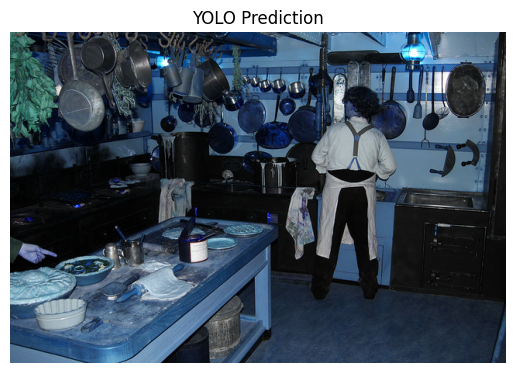


0: 448x640 1 bowl, 1 chair, 1 dining table, 1 oven, 2 refrigerators, 53.3ms
Speed: 1.8ms preprocess, 53.3ms inference, 1.3ms postprocess per image at shape (1, 3, 448, 640)


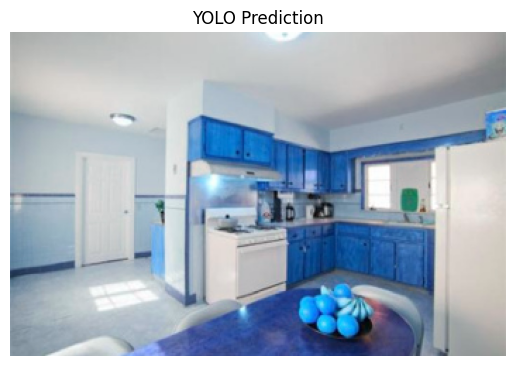


0: 448x640 3 persons, 1 traffic light, 2 umbrellas, 53.6ms
Speed: 1.4ms preprocess, 53.6ms inference, 1.4ms postprocess per image at shape (1, 3, 448, 640)


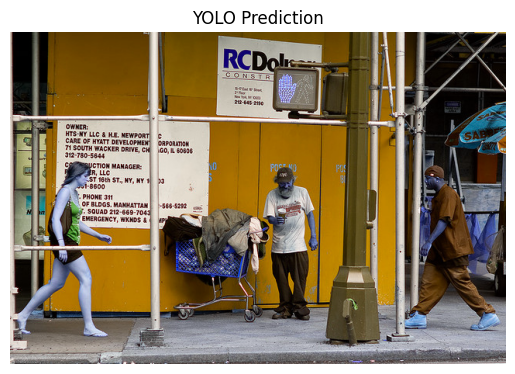

In [69]:
import cv2

def visualize_yolo_prediction(model, data_loader, device='cuda', num_images=3):
    model.to(device)
    model.eval()

    count = 0
    for images, targets in data_loader:
        for img_tensor in images:
            if count >= num_images:
                return

            img_tensor = img_tensor.to(device)

            img_np = img_tensor.permute(1, 2, 0).cpu().numpy()
            img_np = (img_np * 255).astype(np.uint8) if img_np.max() <= 1 else img_np

            img_np = np.ascontiguousarray(img_np)

            results = model([img_np], device=device)
            result = results[0]
            
            result.plot()

            plt.imshow(cv2.cvtColor(img_np, cv2.COLOR_BGR2RGB))
            plt.axis('off')
            plt.title('YOLO Prediction')
            plt.show()

            count += 1

# Visualize predictions from the validation set
visualize_yolo_prediction(model_Yolo_V3, val_loader)


In [81]:
def visualize_yolo_prediction(model, data_loader, device='cuda', num_images=3, show_rec=True):
    """
    Visualize YOLO predictions on images with optional bounding box rectangles and class names.

    Args:
    - model: YOLO model.
    - data_loader: DataLoader containing images and targets.
    - device: Device to run the model on ('cuda' or 'cpu').
    - num_images: Number of images to display.
    - show_rec: Boolean flag to show bounding box rectangles and class names.
    """
    model.to(device)
    model.eval()

    count = 0
    for images, targets in data_loader:
        for img_tensor, target in zip(images, targets):
            if count >= num_images:
                return

            img_tensor = img_tensor.to(device)

            # Convert tensor to numpy array
            img_np = img_tensor.permute(1, 2, 0).cpu().numpy()
            img_np = (img_np * 255).astype(np.uint8) if img_np.max() <= 1 else img_np

            # Ensure the image is contiguous in memory
            img_np = np.ascontiguousarray(img_np)

            # Run the model on the image
            results = model([img_np], device=device)
            result = results[0]  # Get the first result (assuming one image)

            # Create a figure for plotting
            fig, ax = plt.subplots(1, figsize=(12, 9))

            # Optionally draw bounding boxes (rectangles) with 3D-like colors and class names
            if show_rec:
                for box, conf, cls in zip(result.boxes.xyxy, result.boxes.conf, result.boxes.cls):
                    conf = conf.item()  # Confidence score
                    if conf > 0.5:  # Only show boxes with confidence > 0.5
                        x1, y1, x2, y2 = box.cpu().numpy()  # Get box coordinates
                        class_idx = int(cls.item())  # Get class index
                        class_name = result.names[class_idx]  # Get class name

                        # Use a color map to create a gradient effect for the bounding box
                        colormap = plt.cm.viridis  # You can experiment with different colormaps
                        color = colormap(conf)  # Map confidence to a color
                        rgba_color = (color[0], color[1], color[2], 0.5)  # Set the alpha for transparency

                        # Add a bounding box with the color gradient
                        ax.add_patch(
                            plt.Rectangle((x1, y1), x2 - x1, y2 - y1, fill=False, color=rgba_color, linewidth=3)
                        )

                        # Add class name text on the bounding box
                        ax.text(
                            x1, y1 - 10, f'{class_name}: {conf:.2f}', color='white', fontsize=12,
                            bbox=dict(facecolor='black', alpha=0.6, edgecolor='none', boxstyle='round,pad=0.5')
                        )

            # Display the image with annotations
            ax.imshow(cv2.cvtColor(img_np, cv2.COLOR_BGR2RGB))
            ax.axis('off')
            ax.set_title(f'YOLO Prediction (Image {count + 1})', fontsize=16)
            plt.show()

            count += 1


0: 448x640 4 persons, 2 cups, 4 spoons, 3 bowls, 2 ovens, 1 sink, 71.6ms
Speed: 2.2ms preprocess, 71.6ms inference, 2.2ms postprocess per image at shape (1, 3, 448, 640)


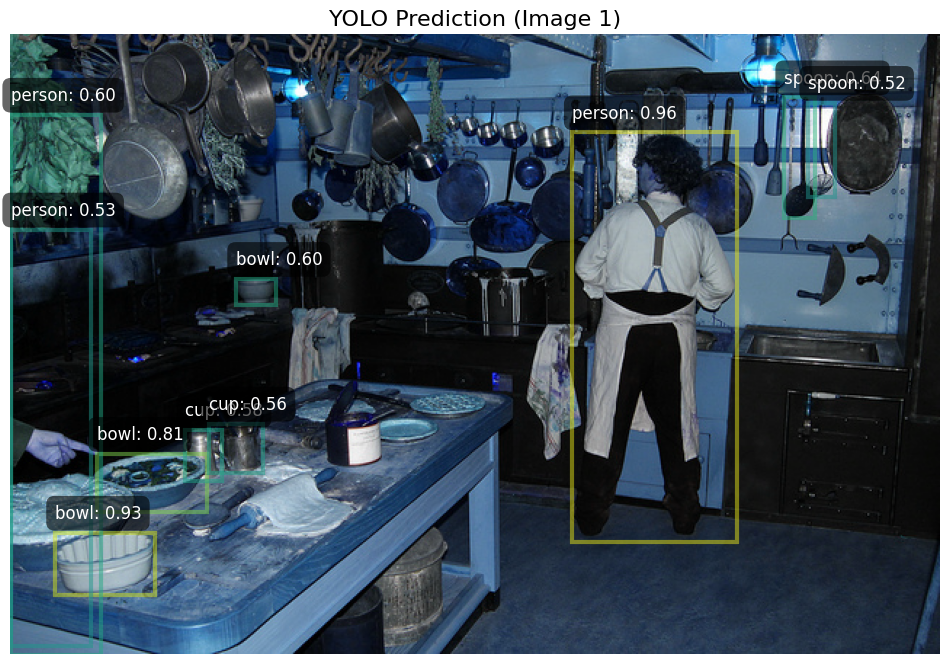


0: 448x640 1 bowl, 1 chair, 1 dining table, 1 oven, 2 refrigerators, 50.4ms
Speed: 1.9ms preprocess, 50.4ms inference, 1.7ms postprocess per image at shape (1, 3, 448, 640)


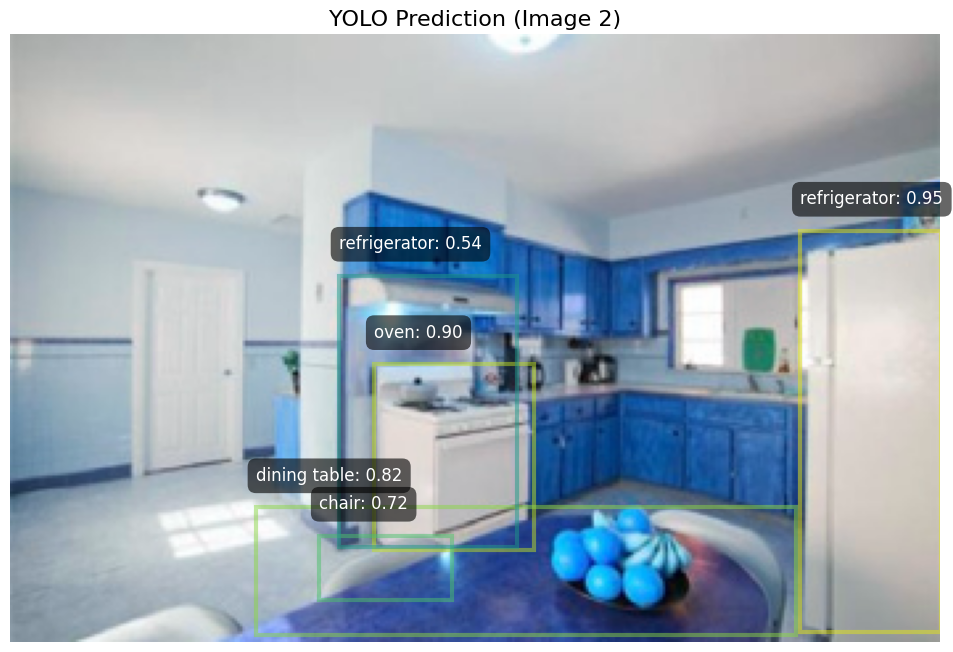


0: 448x640 3 persons, 1 traffic light, 2 umbrellas, 50.4ms
Speed: 1.5ms preprocess, 50.4ms inference, 1.5ms postprocess per image at shape (1, 3, 448, 640)


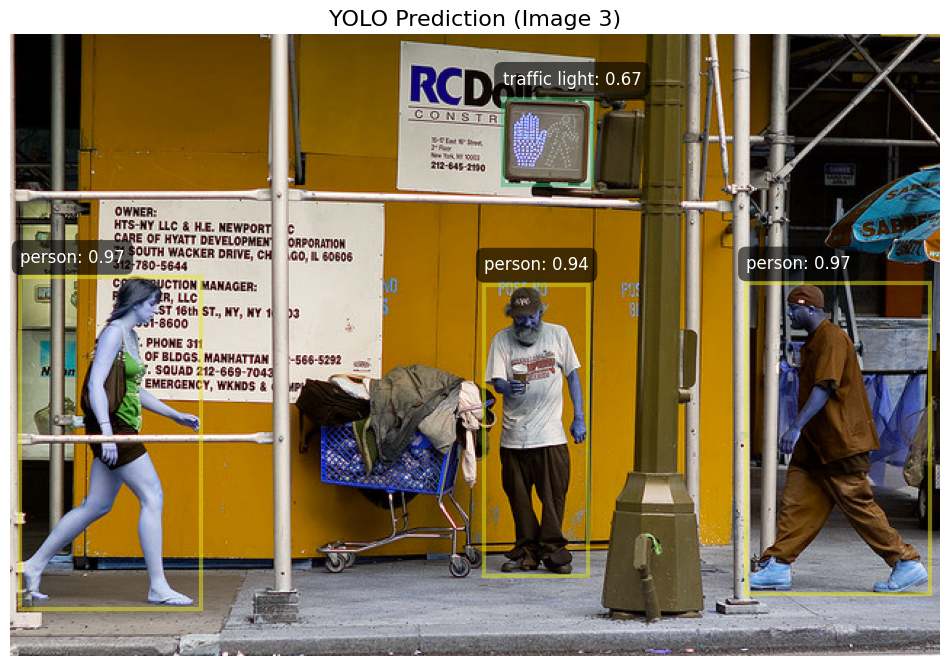

In [82]:
visualize_yolo_prediction(model_Yolo_V3, val_loader, show_rec=True)

In [8]:
def visualize_yolo_video(model, video_path, output_path=None, device='cuda', show_rec=True):
    """
    Visualize YOLO predictions on a video, drawing bounding boxes and class names on each frame.

    Args:
    - model: YOLO model.
    - video_path: Path to the input video.
    - output_path: Path to save the output video (if None, the video will not be saved).
    - device: Device to run the model on ('cuda' or 'cpu').
    - show_rec: Boolean flag to show bounding box rectangles and class names.
    """
    # Initialize video capture
    cap = cv2.VideoCapture(video_path)
    
    # Get the frame width, height, and fps from the input video
    frame_width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
    frame_height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
    fps = cap.get(cv2.CAP_PROP_FPS)

    # If output_path is provided, initialize video writer to save the output video
    if output_path:
        fourcc = cv2.VideoWriter_fourcc(*'XVID')
        out = cv2.VideoWriter(output_path, fourcc, fps, (frame_width, frame_height))

    # Loop through frames of the video
    while cap.isOpened():
        ret, frame = cap.read()
        if not ret:
            break

        # Convert frame to RGB (from BGR used by OpenCV)
        img_np = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)

        # Run the model on the frame
        results = model([img_np], device=device)
        result = results[0]  # Get the first result (assuming one frame)

        # Draw bounding boxes and class names on the frame
        if show_rec:
            for box, conf, cls in zip(result.boxes.xyxy, result.boxes.conf, result.boxes.cls):
                conf = conf.item()  # Confidence score
                if conf > 0.5:  # Only show boxes with confidence > 0.5
                    x1, y1, x2, y2 = box.cpu().numpy()  # Get box coordinates
                    class_idx = int(cls.item())  # Get class index
                    class_name = result.names[class_idx]  # Get class name

                    # Draw the bounding box
                    cv2.rectangle(frame, (int(x1), int(y1)), (int(x2), int(y2)), (0, 255, 0), 3)
                    cv2.putText(frame, f'{class_name}: {conf:.2f}', (int(x1), int(y1) - 10),
                                cv2.FONT_HERSHEY_SIMPLEX, 0.9, (0, 255, 0), 2)

        # Show the resulting frame
        cv2.imshow('YOLO Prediction', frame)

        # Write the frame to the output video if specified
        if output_path:
            out.write(frame)

        # Press 'q' to quit the video playback
        if cv2.waitKey(1) & 0xFF == ord('q'):
            break

    # Release the video capture and writer objects
    cap.release()
    if output_path:
        out.release()

    # Close all OpenCV windows
    cv2.destroyAllWindows()

In [85]:
import gdown

# Google Drive file ID
file_id = '1p1pcr-B_Xa0wZhNAiqFkk3NAzaTakYVl'
url = f'https://drive.google.com/uc?export=download&id={file_id}'

# Output path where the video will be saved
output_path = 'input_video.mp4'

# Download the video from Google Drive with quiet=True to suppress output
gdown.download(url, output_path, quiet=True)

'input_video.mp4'

In [ ]:
visualize_yolo_video(model_Yolo_V3, 'input_video.mp4', output_path='output_video.avi', show_rec=True)



0: 384x640 4 persons, 2 cars, 1 truck, 76.8ms
Speed: 5.0ms preprocess, 76.8ms inference, 178.1ms postprocess per image at shape (1, 3, 384, 640)


In [7]:
import os
import zipfile
from tqdm import tqdm

def get_directory_input():
    """Prompts the user to enter directory paths they want to zip."""
    directories = []
    print("Enter the paths of the directories/files you want to zip.")
    print("Type 'done' when you're finished entering paths.")
    while True:
        user_input = input("Enter path: ").strip()
        if user_input.lower() == 'done':
            break
        elif os.path.exists(user_input):
            directories.append(user_input)
        else:
            print(f"Invalid path: {user_input}. Please try again.")
    return directories

def get_zip_filename():
    """Prompts the user to input the desired zip filename."""
    zip_filename = input("Enter the name for the zip file (e.g., my_archive.zip): ").strip()
    if not zip_filename.endswith('.zip'):
        zip_filename += '.zip'
    return zip_filename

# Get the directories or files the user wants to zip
directories_to_zip = get_directory_input()

# Get the desired zip file name
zip_filename = get_zip_filename()

# Calculate the total number of files to add to the zip
total_files = sum([len(files) for directory_path in directories_to_zip for _, _, files in os.walk(directory_path)])

# Create the Zip file with a progress bar
with zipfile.ZipFile(zip_filename, 'w', zipfile.ZIP_DEFLATED) as zipf:
    with tqdm(total=total_files, desc="Zipping files", unit="file") as pbar:
        for directory_path in directories_to_zip:
            for root, dirs, files in os.walk(directory_path):
                for file in files:
                    file_path = os.path.join(root, file)
                    # Add file to the zip file
                    zipf.write(file_path, os.path.relpath(file_path, directory_path))
                    pbar.update(1)  # Update progress bar for each file added

print(f"Files have been successfully zipped and saved as {zip_filename}")

Enter the paths of the directories/files you want to zip.
Type 'done' when you're finished entering paths.


Enter path:  /kaggle/working/best_model.pth
Enter path:  /kaggle/working/input_video.mp4
Enter path:  /kaggle/working/my_fasterrcnn_exports
Enter path:  /kaggle/working/yolo11n.pt
Enter path:  /kaggle/working/yolov3u.pt
Enter path:  done
Enter the name for the zip file (e.g., my_archive.zip):  coco_archive.zip


Zipping files: 100%|██████████| 2/2 [00:16<00:00,  8.30s/file]

Files have been successfully zipped and saved as coco_archive.zip
